# Introduction to Generative Modeling

Deep neural networks are used mainly for supervised learning: classification or regression. Generative Adversarial Networks or GANs, however, use neural networks for a very different purpose: Generative modeling

> Generative modeling is an unsupervised learning task in machine learning that involves automatically discovering and learning the regularities or patterns in input data in such a way that the model can be used to generate or output new examples that plausibly could have been drawn from the original dataset. - [Source](https://machinelearningmastery.com/what-are-generative-adversarial-networks-gans/)

To get a sense of the power of generative models, just visit [thispersondoesnotexist.com](https://thispersondoesnotexist.com). Every time you reload the page, a new image of a person's face is generated on the fly. The results are pretty fascinating:

<img src="https://imgix.bustle.com/inverse/4b/17/8f/0e/cf91/4506/99c7/e6a491c5d4ac/these-people-are-not-real--they-were-produced-by-our-generator-that-allows-control-over-different-a.png" style="width:480px; margin-bottom:32px"/>

While there are many approaches used for generative modeling, a Generative Adversarial Network takes the following approach:

<img src="https://i.imgur.com/6NMdO9u.png" style="width:420px; margin-bottom:32px"/>

There are two neural networks: a *Generator* and a *Discriminator*. The generator generates a "fake" sample given a random vector/matrix, and the discriminator attempts to detect whether a given sample is "real" (picked from the training data) or "fake" (generated by the generator). Training happens in tandem: we train the discriminator for a few epochs, then train the generator for a few epochs, and repeat. This way both the generator and the discriminator get better at doing their jobs.

GANs however, can be notoriously difficult to train, and are extremely sensitive to hyperparameters, activation functions and regularization. In this tutorial, we'll train a GAN to generate images of anime characters' faces.

<img src="https://i.imgur.com/NaKtJs0.png" width="360" style="margin-bottom:32px"/>


We'll use the [Anime Face Dataset](https://github.com/Mckinsey666/Anime-Face-Dataset), which consists of over 63,000 cropped anime faces. Note that generative modeling is an unsupervised learning task, so the images do not have any labels.

## Downloading and Exploring the Data

We can use the [`opendatasets`](https://github.com/JovianML/opendatasets) library to download the [dataset](https://www.kaggle.com/splcher/animefacedataset) from Kaggle. `opendatasets` uses the [Kaggle Official API](https://github.com/Kaggle/kaggle-api) for downloading datasets from Kaggle.  Follow these steps to find your API credentials:

. When you run `opendatsets.download`, you will be asked to enter your username & Kaggle API, which you can get from the file downloaded in step 2.


In [ ]:
!pip install opendatasets --upgrade --quiet

In [ ]:
import opendatasets as od

dataset_url = 'https://www.kaggle.com/datasets/anshtanwar/jellyfish-types'
od.download(dataset_url)

Skipping, found downloaded files in "./jellyfish-types" (use force=True to force download)


The dataset has a single folder called `images` which contains all 63,000+ images in JPG format.

In [ ]:
import os

DATA_DIR = '/content/jellyfish-types'
print(os.listdir(DATA_DIR))

['lions_mane_jellyfish', 'blue_jellyfish', 'Moon_jellyfish', 'compass_jellyfish', 'Train_Test_Valid', 'barrel_jellyfish', 'mauve_stinger_jellyfish']


In [ ]:
print(os.listdir(DATA_DIR+'/Moon_jellyfish')[:10])

['45.jpg', 'aug-21-30.jpg', '01.jpg', '40.jpg', 'aug-92-58.jpg', 'aug-80-45.jpg', 'aug-9-13.jpg', '42.jpg', 'aug-88-54.jpg', 'aug-40-53.jpg']


Let's load this dataset using the `ImageFolder` class from `torchvision`. We will also resize and crop the images to 64x64 px, and normalize the pixel values with a mean & standard deviation of 0.5 for each channel. This will ensure that pixel values are in the range `(-1, 1)`, which is more  convenient for training the discriminator. We will also create a data loader to load the data in batches.

In [ ]:
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as T

In [ ]:
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [ ]:
train_ds = ImageFolder(DATA_DIR, transform=T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize(*stats)]))

train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True)

Let's create helper functions to denormalize the image tensors and display some sample images from a training batch.

In [ ]:
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline

here denorm function denormalise the image back to 0,1 range to show the images


In [ ]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]

show_images simply show the images and nmax is no. of images. make_grid is a pytorch function ,it has colour palet in the 1st dimention therefor we use permute as imshow is plt func which has palet in last didmention

In [ ]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break

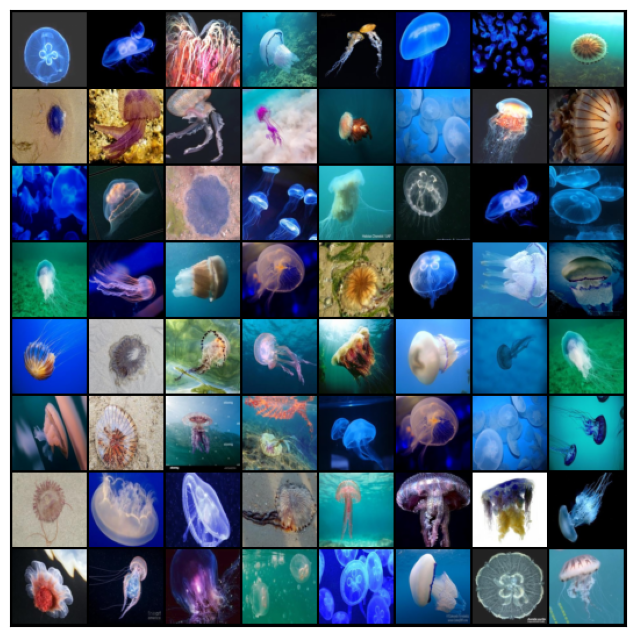

In [ ]:
show_batch(train_dl)

## Using a GPU

To seamlessly use a GPU, if one is available, we define a couple of helper functions (`get_default_device` & `to_device`) and a helper class `DeviceDataLoader` to move our model & data to the GPU, if one is available.

In [ ]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')

def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device

    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl:
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

Based on where you're running this notebook, your default device could be a CPU (`torch.device('cpu')`) or a GPU (`torch.device('cuda')`).

In [ ]:
device = get_default_device()
device

device(type='cuda')

We can now move our training data loader using `DeviceDataLoader` for automatically transferring batches of data to the GPU (if available).

In [ ]:
train_dl = DeviceDataLoader(train_dl, device)

## Discriminator Network

The discriminator takes an image as input, and tries to classify it as "real" or "generated". In this sense, it's like any other neural network. We'll use a convolutional neural networks (CNN) which outputs a single number output for every image. We'll use stride of 2 to progressively reduce the size of the output feature map.

![](https://github.com/vdumoulin/conv_arithmetic/raw/master/gif/padding_strides_odd.gif)

In [ ]:
import torch.nn as nn

we use sequential function and binary classification as we want the descriminatior output in range 0to1  and  0 being generated image and close to 1 means image from dataset.
when we have multi class we use softmax but here is only 1 class we use sigmoid

In [ ]:
discriminator = nn.Sequential(
    # in: 3 x 64 x 64

    nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64), #Batch normalization is a technique used to normalize the activations of each layer across a mini-batch of data
    nn.LeakyReLU(0.2, inplace=True),
    # out: 64 x 32 x 32

    nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 128 x 16 x 16

    nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 256 x 8 x 8

    nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(512),
    nn.LeakyReLU(0.2, inplace=True),
    # out: 512 x 4 x 4

    nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
    # out: 1 x 1 x 1

    nn.Flatten(), #The Flatten layer is a simple layer that reshapes the input tensor into a one-dimensional (1D) tensor.
    nn.Sigmoid())

sigmoid function = 1/(1+e^(-x)) convert any no. in the range -1to1
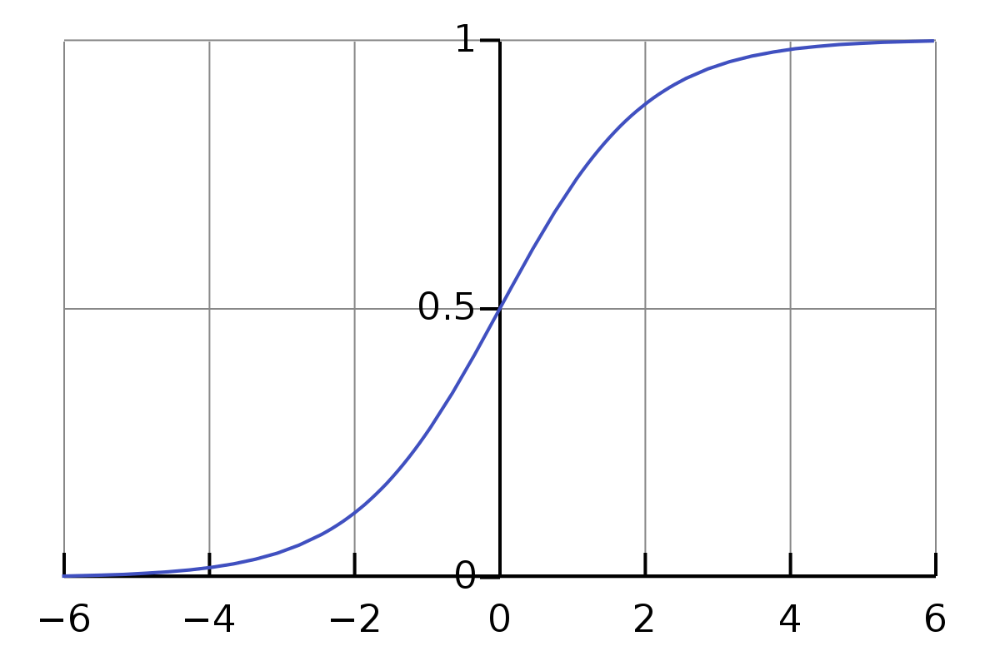

Note that we're using the Leaky ReLU activation for the discriminator. leaky rectified linear unit

<img src="https://cdn-images-1.medium.com/max/1600/1*ypsvQH7kvtI2BhzR2eT_Sw.png" width="420">


>  Different from the regular ReLU function, Leaky ReLU allows the pass of a small gradient signal for negative values. As a result, it makes the gradients from the discriminator flows stronger into the generator. Instead of passing a gradient (slope) of 0 in the back-prop pass, it passes a small negative gradient.  - [Source](https://sthalles.github.io/advanced_gans/)

Just like any other binary classification model, the output of the discriminator is a single number between 0 and 1, which can be interpreted as the probability of the input image being real i.e. picked from the original dataset.

Let's move the discriminator model to the chosen device.

In [ ]:
discriminator = to_device(discriminator, device)

In [ ]:
from torch import nn
import torch
import pydot
import graphviz

dot = pydot.Dot(graph_type='digraph')
for idx, module in enumerate(discriminator):
    if isinstance(module, nn.Conv2d):
        dot.add_node(pydot.Node(name=f"layer_{idx}", label=f"Conv2d\n{module.out_channels, module.kernel_size, module.stride}"))
    elif isinstance(module, nn.BatchNorm2d):
        dot.add_node(pydot.Node(name=f"layer_{idx}", label=f"BatchNorm2d\n{module.num_features}"))
    elif isinstance(module, nn.LeakyReLU):
        dot.add_node(pydot.Node(name=f"layer_{idx}", label=f"LeakyReLU\n{module.negative_slope}"))
    elif isinstance(module, nn.Flatten):
        dot.add_node(pydot.Node(name=f"layer_{idx}", label="Flatten"))
    elif isinstance(module, nn.Sigmoid):
        dot.add_node(pydot.Node(name=f"layer_{idx}", label="Sigmoid"))

    if idx != 0:
        dot.add_edge(pydot.Edge(name=f"layer_{idx-1}->layer_{idx}", src=f"layer_{idx-1}", dst=f"layer_{idx}"))

# Save the dot file as a png
dot.write_png("model.png")

## Generator Network

The input to the generator is typically a vector or a matrix of random numbers (referred to as a latent tensor) which is used as a seed for generating an image. The generator will convert a latent tensor of shape `(128, 1, 1)` into an image tensor of shape `3 x 28 x 28`. To achive this, we'll use the `ConvTranspose2d` layer from PyTorch, which is performs to as a *transposed convolution* (also referred to as a *deconvolution*). [Learn more](https://github.com/vdumoulin/conv_arithmetic/blob/master/README.md#transposed-convolution-animations)

![](https://i.imgur.com/DRvK546.gif)

In [ ]:
latent_size = 128

In [ ]:
generator = nn.Sequential(
    # in: latent_size x 1 x 1

    nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
    nn.BatchNorm2d(512),
    nn.ReLU(True),
    # out: 512 x 4 x 4

    nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(256),
    nn.ReLU(True),
    # out: 256 x 8 x 8

    nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(128),
    nn.ReLU(True),
    # out: 128 x 16 x 16

    nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
    nn.BatchNorm2d(64),
    nn.ReLU(True),
    # out: 64 x 32 x 32

    nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
    nn.Tanh()
    # out: 3 x 64 x 64
)

We use the TanH activation function for the output layer of the generator.

<img src="https://nic.schraudolph.org/teach/NNcourse/figs/tanh.gif" width="420" >

> "The ReLU activation (Nair & Hinton, 2010) is used in the generator with the exception of the output layer which uses the Tanh function. We observed that using a bounded activation allowed the model to learn more quickly to saturate and cover the color space of the training distribution. Within the discriminator we found the leaky rectified activation (Maas et al., 2013) (Xu et al., 2015) to work well, especially for higher resolution modeling." - [Source](https://stackoverflow.com/questions/41489907/generative-adversarial-networks-tanh)


Note that since the outputs of the TanH activation lie in the range `[-1,1]`, we have applied the similar transformation to the images in the training dataset. Let's generate some outputs using the generator and view them as images by transforming and denormalizing the output.

torch.Size([128, 128, 1, 1])
torch.Size([128, 3, 64, 64])


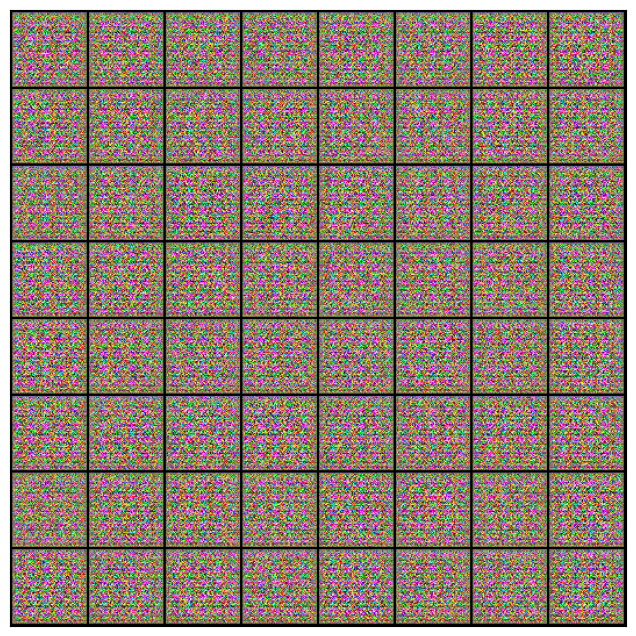

In [ ]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
print(xb.shape)
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)

As one might expect, the output from the generator is basically random noise, since we haven't trained it yet.

Let's move the generator to the chosen device.

In [ ]:
generator = to_device(generator, device)

## Discriminator Training

Since the discriminator is a binary classification model, we can use the binary cross entropy loss function to quantify how well it is able to differentiate between real and generated images.

<img src="https://image.slidesharecdn.com/chrishokamp-dublinnlp3-160805110319/95/task-based-learning-for-nlp-going-beyond-cross-entropy-chris-hokamp-10-638.jpg?cb=1470395213" width="420" >

In [ ]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()

    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward() #gradient of loss w.r.t every single weight of the descriminator
    opt_d.step() # gradient descent . modify the weights of the descriminator
    return loss.item(), real_score, fake_score

Here are the steps involved in training the discriminator.

- We expect the discriminator to output 1 if the image was picked from the real MNIST dataset, and 0 if it was generated using the generator network.

- We first pass a batch of real images, and compute the loss, setting the target labels to 1.

- Then we pass a batch of fake images (generated using the generator) pass them into the discriminator, and compute the loss, setting the target labels to 0.

- Finally we add the two losses and use the overall loss to perform gradient descent to adjust the weights of the discriminator.

It's important to note that we don't change the weights of the generator model while training the discriminator (`opt_d` only affects the `discriminator.parameters()`)

## Generator Training

Since the outputs of the generator are images, it's not obvious how we can train the generator. This is where we employ a rather elegant trick, which is to use the discriminator as a part of the loss function. Here's how it works:

- We generate a batch of images using the generator, pass the into the discriminator.

- We calculate the loss by setting the target labels to 1 i.e. real. We do this because the generator's objective is to "fool" the discriminator.

- We use the loss to perform gradient descent i.e. change the weights of the generator, so it gets better at generating real-like images to "fool" the discriminator.

Here's what this looks like in code.

In [ ]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()

    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)

    # Update generator weights
    loss.backward()
    opt_g.step()

    return loss.item()

Let's create a directory where we can save intermediate outputs from the generator to visually inspect the progress of the model. We'll also create a helper function to export the generated images.

In [ ]:
from torchvision.utils import save_image

In [ ]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [ ]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))

We'll use a fixed set of input vectors to the generator to see how the individual generated images evolve over time as we train the model. Let's save one set of images before we start training our model.

In [ ]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device)

Saving generated-images-0000.png


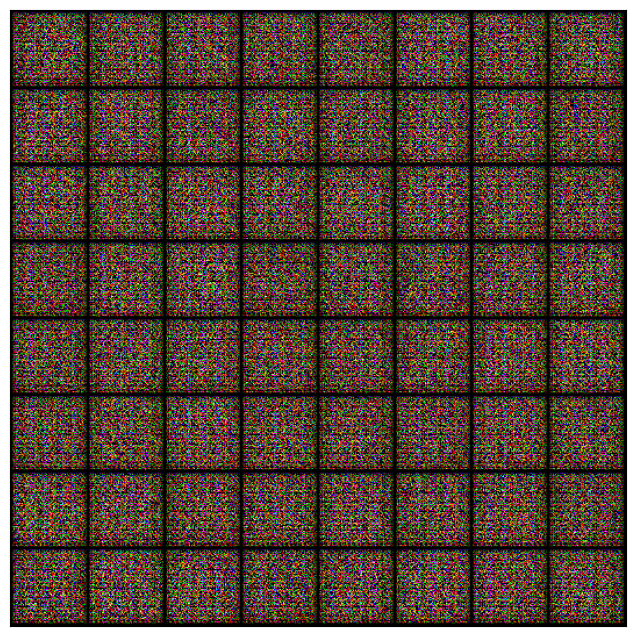

In [ ]:
save_samples(0, fixed_latent)

## Full Training Loop

Let's define a `fit` function to train the discriminator and generator in tandem for each batch of training data. We'll use the Adam optimizer with some custom parameters (betas) that are known to work well for GANs. We will also save some sample generated images at regular intervals for inspection.

<img src="https://i.imgur.com/6NMdO9u.png" style="max-width:420px; margin-bottom:32px"/>



In [ ]:
from tqdm.notebook import tqdm
import torch.nn.functional as F

In [ ]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()

    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []

    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))

    for epoch in range(epochs):
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)

        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)

        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))

        # Save generated images
        save_samples(epoch+start_idx, fixed_latent, show=False)

    return losses_g, losses_d, real_scores, fake_scores

We are now ready to train the model. Try different learning rates to see if you can maintain the fine balance between the training the generator and the discriminator.

In [ ]:
lr = 0.0002 #learning rate
epochs = 1000

In [ ]:
history = fit(epochs, lr)

  0%|          | 0/15 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:558: UserWarning: This DataLoader will create 3 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch [1/1000], loss_g: 12.8013, loss_d: 0.2015, real_score: 0.8548, fake_score: 0.0001
Saving generated-images-0001.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [2/1000], loss_g: 10.8612, loss_d: 0.1434, real_score: 0.9020, fake_score: 0.0000
Saving generated-images-0002.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [3/1000], loss_g: 10.3694, loss_d: 0.0378, real_score: 0.9683, fake_score: 0.0000
Saving generated-images-0003.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [4/1000], loss_g: 11.0522, loss_d: 0.0271, real_score: 0.9745, fake_score: 0.0000
Saving generated-images-0004.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [5/1000], loss_g: 6.9598, loss_d: 0.0259, real_score: 0.9765, fake_score: 0.0009
Saving generated-images-0005.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [6/1000], loss_g: 6.5483, loss_d: 0.0761, real_score: 0.9958, fake_score: 0.0692
Saving generated-images-0006.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [7/1000], loss_g: 7.5748, loss_d: 0.0674, real_score: 0.9758, fake_score: 0.0396
Saving generated-images-0007.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [8/1000], loss_g: 7.6091, loss_d: 0.0273, real_score: 0.9804, fake_score: 0.0068
Saving generated-images-0008.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [9/1000], loss_g: 6.2025, loss_d: 0.1012, real_score: 0.9254, fake_score: 0.0122
Saving generated-images-0009.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [10/1000], loss_g: 13.4930, loss_d: 15.8887, real_score: 0.0002, fake_score: 0.0000
Saving generated-images-0010.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [11/1000], loss_g: 3.0446, loss_d: 0.3174, real_score: 0.8332, fake_score: 0.1019
Saving generated-images-0011.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [12/1000], loss_g: 5.2057, loss_d: 0.1530, real_score: 0.9516, fake_score: 0.0960
Saving generated-images-0012.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [13/1000], loss_g: 6.1141, loss_d: 6.8644, real_score: 0.0025, fake_score: 0.0001
Saving generated-images-0013.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [14/1000], loss_g: 3.7483, loss_d: 0.1620, real_score: 0.9131, fake_score: 0.0646
Saving generated-images-0014.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [15/1000], loss_g: 8.9003, loss_d: 1.3886, real_score: 0.9708, fake_score: 0.4752
Saving generated-images-0015.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [16/1000], loss_g: 4.8214, loss_d: 0.1714, real_score: 0.9400, fake_score: 0.0984
Saving generated-images-0016.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [17/1000], loss_g: 3.1195, loss_d: 0.2723, real_score: 0.8548, fake_score: 0.0971
Saving generated-images-0017.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [18/1000], loss_g: 3.3301, loss_d: 0.4115, real_score: 0.8365, fake_score: 0.1839
Saving generated-images-0018.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [19/1000], loss_g: 2.4445, loss_d: 0.5911, real_score: 0.7164, fake_score: 0.1462
Saving generated-images-0019.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [20/1000], loss_g: 1.4341, loss_d: 0.3952, real_score: 0.7636, fake_score: 0.0922
Saving generated-images-0020.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [21/1000], loss_g: 3.8202, loss_d: 0.2626, real_score: 0.9652, fake_score: 0.1916
Saving generated-images-0021.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [22/1000], loss_g: 2.1215, loss_d: 0.2088, real_score: 0.8965, fake_score: 0.0889
Saving generated-images-0022.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [23/1000], loss_g: 3.2284, loss_d: 0.3709, real_score: 0.8379, fake_score: 0.1617
Saving generated-images-0023.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [24/1000], loss_g: 4.9820, loss_d: 0.4282, real_score: 0.7214, fake_score: 0.0063
Saving generated-images-0024.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [25/1000], loss_g: 4.4676, loss_d: 0.3278, real_score: 0.8834, fake_score: 0.1635
Saving generated-images-0025.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [26/1000], loss_g: 3.1984, loss_d: 0.3143, real_score: 0.8355, fake_score: 0.1051
Saving generated-images-0026.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [27/1000], loss_g: 3.2118, loss_d: 0.2420, real_score: 0.9263, fake_score: 0.1439
Saving generated-images-0027.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [28/1000], loss_g: 1.5154, loss_d: 2.3779, real_score: 0.1405, fake_score: 0.0102
Saving generated-images-0028.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [29/1000], loss_g: 7.0327, loss_d: 0.8832, real_score: 0.9649, fake_score: 0.4897
Saving generated-images-0029.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [30/1000], loss_g: 3.9105, loss_d: 0.9328, real_score: 0.9656, fake_score: 0.5268
Saving generated-images-0030.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [31/1000], loss_g: 2.3814, loss_d: 0.5266, real_score: 0.6687, fake_score: 0.0736
Saving generated-images-0031.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [32/1000], loss_g: 4.9380, loss_d: 1.0378, real_score: 0.8840, fake_score: 0.5706
Saving generated-images-0032.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [33/1000], loss_g: 0.9120, loss_d: 1.1507, real_score: 0.4050, fake_score: 0.0263
Saving generated-images-0033.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [34/1000], loss_g: 3.6747, loss_d: 0.4711, real_score: 0.8022, fake_score: 0.1909
Saving generated-images-0034.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [35/1000], loss_g: 3.2114, loss_d: 0.4775, real_score: 0.8797, fake_score: 0.2782
Saving generated-images-0035.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [36/1000], loss_g: 6.7750, loss_d: 1.8521, real_score: 0.9874, fake_score: 0.7329
Saving generated-images-0036.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [37/1000], loss_g: 2.4751, loss_d: 0.3235, real_score: 0.7887, fake_score: 0.0630
Saving generated-images-0037.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [38/1000], loss_g: 2.6859, loss_d: 0.4840, real_score: 0.8475, fake_score: 0.2492
Saving generated-images-0038.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [39/1000], loss_g: 3.8042, loss_d: 0.3193, real_score: 0.9115, fake_score: 0.1944
Saving generated-images-0039.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [40/1000], loss_g: 3.0718, loss_d: 0.3488, real_score: 0.8923, fake_score: 0.1903
Saving generated-images-0040.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [41/1000], loss_g: 3.5432, loss_d: 0.4602, real_score: 0.9478, fake_score: 0.3131
Saving generated-images-0041.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [42/1000], loss_g: 2.0478, loss_d: 0.3232, real_score: 0.7870, fake_score: 0.0623
Saving generated-images-0042.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [43/1000], loss_g: 2.4978, loss_d: 0.4209, real_score: 0.8785, fake_score: 0.2332
Saving generated-images-0043.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [44/1000], loss_g: 2.1769, loss_d: 0.3628, real_score: 0.9195, fake_score: 0.2263
Saving generated-images-0044.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [45/1000], loss_g: 3.3916, loss_d: 0.4186, real_score: 0.9080, fake_score: 0.2563
Saving generated-images-0045.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [46/1000], loss_g: 3.0598, loss_d: 0.3541, real_score: 0.8135, fake_score: 0.1215
Saving generated-images-0046.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [47/1000], loss_g: 2.1461, loss_d: 0.4455, real_score: 0.7541, fake_score: 0.1137
Saving generated-images-0047.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [48/1000], loss_g: 2.5060, loss_d: 2.7483, real_score: 0.1061, fake_score: 0.0042
Saving generated-images-0048.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [49/1000], loss_g: 3.9014, loss_d: 0.4799, real_score: 0.8802, fake_score: 0.2771
Saving generated-images-0049.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [50/1000], loss_g: 2.3985, loss_d: 0.2638, real_score: 0.8487, fake_score: 0.0895
Saving generated-images-0050.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [51/1000], loss_g: 3.9314, loss_d: 0.1939, real_score: 0.9469, fake_score: 0.1244
Saving generated-images-0051.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [52/1000], loss_g: 1.1029, loss_d: 0.4038, real_score: 0.7105, fake_score: 0.0370
Saving generated-images-0052.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [53/1000], loss_g: 3.0664, loss_d: 0.3523, real_score: 0.8886, fake_score: 0.1978
Saving generated-images-0053.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [54/1000], loss_g: 2.7641, loss_d: 0.6769, real_score: 0.5716, fake_score: 0.0497
Saving generated-images-0054.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [55/1000], loss_g: 3.8938, loss_d: 0.2242, real_score: 0.9419, fake_score: 0.1455
Saving generated-images-0055.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [56/1000], loss_g: 3.0067, loss_d: 0.4270, real_score: 0.8831, fake_score: 0.2463
Saving generated-images-0056.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [57/1000], loss_g: 3.1076, loss_d: 0.4233, real_score: 0.7499, fake_score: 0.0824
Saving generated-images-0057.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [58/1000], loss_g: 3.5865, loss_d: 0.4469, real_score: 0.8686, fake_score: 0.2385
Saving generated-images-0058.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [59/1000], loss_g: 2.8365, loss_d: 0.2804, real_score: 0.9416, fake_score: 0.1896
Saving generated-images-0059.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [60/1000], loss_g: 2.6392, loss_d: 0.4263, real_score: 0.7819, fake_score: 0.1444
Saving generated-images-0060.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [61/1000], loss_g: 2.0520, loss_d: 0.3053, real_score: 0.7982, fake_score: 0.0587
Saving generated-images-0061.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [62/1000], loss_g: 3.5194, loss_d: 0.3525, real_score: 0.9305, fake_score: 0.2316
Saving generated-images-0062.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [63/1000], loss_g: 3.5894, loss_d: 0.4887, real_score: 0.9368, fake_score: 0.3239
Saving generated-images-0063.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [64/1000], loss_g: 4.0556, loss_d: 0.2178, real_score: 0.8558, fake_score: 0.0527
Saving generated-images-0064.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [65/1000], loss_g: 2.2266, loss_d: 0.3054, real_score: 0.8495, fake_score: 0.1152
Saving generated-images-0065.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [66/1000], loss_g: 4.8201, loss_d: 0.5641, real_score: 0.9447, fake_score: 0.3543
Saving generated-images-0066.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [67/1000], loss_g: 4.0364, loss_d: 0.2482, real_score: 0.8991, fake_score: 0.1250
Saving generated-images-0067.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [68/1000], loss_g: 5.1531, loss_d: 0.2253, real_score: 0.9543, fake_score: 0.1551
Saving generated-images-0068.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [69/1000], loss_g: 2.9121, loss_d: 0.4603, real_score: 0.7529, fake_score: 0.1341
Saving generated-images-0069.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [70/1000], loss_g: 3.2923, loss_d: 0.1933, real_score: 0.8996, fake_score: 0.0778
Saving generated-images-0070.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [71/1000], loss_g: 0.9172, loss_d: 0.8634, real_score: 0.4830, fake_score: 0.0292
Saving generated-images-0071.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [72/1000], loss_g: 2.5832, loss_d: 0.3980, real_score: 0.7485, fake_score: 0.0794
Saving generated-images-0072.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [73/1000], loss_g: 4.7973, loss_d: 0.5163, real_score: 0.9544, fake_score: 0.3470
Saving generated-images-0073.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [74/1000], loss_g: 3.2390, loss_d: 0.3577, real_score: 0.8505, fake_score: 0.1645
Saving generated-images-0074.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [75/1000], loss_g: 4.7084, loss_d: 0.2989, real_score: 0.9721, fake_score: 0.2166
Saving generated-images-0075.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [76/1000], loss_g: 4.1139, loss_d: 0.6150, real_score: 0.9287, fake_score: 0.3322
Saving generated-images-0076.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [77/1000], loss_g: 3.8128, loss_d: 0.2699, real_score: 0.9592, fake_score: 0.1922
Saving generated-images-0077.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [78/1000], loss_g: 4.1279, loss_d: 0.2974, real_score: 0.9337, fake_score: 0.1894
Saving generated-images-0078.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [79/1000], loss_g: 3.5524, loss_d: 0.1231, real_score: 0.9489, fake_score: 0.0641
Saving generated-images-0079.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [80/1000], loss_g: 4.9392, loss_d: 0.2463, real_score: 0.9579, fake_score: 0.1766
Saving generated-images-0080.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [81/1000], loss_g: 3.0899, loss_d: 0.2727, real_score: 0.8031, fake_score: 0.0259
Saving generated-images-0081.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [82/1000], loss_g: 2.2665, loss_d: 0.5410, real_score: 0.7245, fake_score: 0.1473
Saving generated-images-0082.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [83/1000], loss_g: 3.8625, loss_d: 0.2764, real_score: 0.8757, fake_score: 0.1193
Saving generated-images-0083.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [84/1000], loss_g: 2.1332, loss_d: 0.2831, real_score: 0.8560, fake_score: 0.1068
Saving generated-images-0084.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [85/1000], loss_g: 2.3586, loss_d: 0.2156, real_score: 0.8734, fake_score: 0.0681
Saving generated-images-0085.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [86/1000], loss_g: 4.0158, loss_d: 0.1482, real_score: 0.9315, fake_score: 0.0703
Saving generated-images-0086.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [87/1000], loss_g: 3.1941, loss_d: 0.9299, real_score: 0.5341, fake_score: 0.0373
Saving generated-images-0087.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [88/1000], loss_g: 3.5341, loss_d: 0.3924, real_score: 0.8370, fake_score: 0.1456
Saving generated-images-0088.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [89/1000], loss_g: 2.7948, loss_d: 0.8777, real_score: 0.4886, fake_score: 0.0141
Saving generated-images-0089.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [90/1000], loss_g: 3.2223, loss_d: 0.1380, real_score: 0.9569, fake_score: 0.0862
Saving generated-images-0090.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [91/1000], loss_g: 3.8500, loss_d: 0.1644, real_score: 0.9605, fake_score: 0.1116
Saving generated-images-0091.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [92/1000], loss_g: 2.1708, loss_d: 0.2249, real_score: 0.8552, fake_score: 0.0556
Saving generated-images-0092.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [93/1000], loss_g: 0.7586, loss_d: 0.5019, real_score: 0.6509, fake_score: 0.0209
Saving generated-images-0093.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [94/1000], loss_g: 4.2124, loss_d: 0.2373, real_score: 0.9632, fake_score: 0.1650
Saving generated-images-0094.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [95/1000], loss_g: 3.3794, loss_d: 0.1894, real_score: 0.8698, fake_score: 0.0441
Saving generated-images-0095.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [96/1000], loss_g: 4.1349, loss_d: 0.1897, real_score: 0.9921, fake_score: 0.1533
Saving generated-images-0096.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [97/1000], loss_g: 4.8381, loss_d: 0.0904, real_score: 0.9864, fake_score: 0.0715
Saving generated-images-0097.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [98/1000], loss_g: 3.4916, loss_d: 0.4665, real_score: 0.8359, fake_score: 0.2219
Saving generated-images-0098.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [99/1000], loss_g: 3.7720, loss_d: 0.3154, real_score: 0.9172, fake_score: 0.1808
Saving generated-images-0099.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [100/1000], loss_g: 5.6761, loss_d: 0.2600, real_score: 0.9636, fake_score: 0.1850
Saving generated-images-0100.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [101/1000], loss_g: 4.2933, loss_d: 0.2653, real_score: 0.8702, fake_score: 0.0994
Saving generated-images-0101.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [102/1000], loss_g: 4.6688, loss_d: 0.2725, real_score: 0.9716, fake_score: 0.2030
Saving generated-images-0102.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [103/1000], loss_g: 3.1159, loss_d: 0.2213, real_score: 0.8600, fake_score: 0.0548
Saving generated-images-0103.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [104/1000], loss_g: 3.4707, loss_d: 0.3339, real_score: 0.7367, fake_score: 0.0097
Saving generated-images-0104.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [105/1000], loss_g: 3.5601, loss_d: 0.1439, real_score: 0.9289, fake_score: 0.0626
Saving generated-images-0105.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [106/1000], loss_g: 4.7906, loss_d: 0.1080, real_score: 0.9689, fake_score: 0.0705
Saving generated-images-0106.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [107/1000], loss_g: 4.5992, loss_d: 0.1397, real_score: 0.9590, fake_score: 0.0868
Saving generated-images-0107.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [108/1000], loss_g: 6.5934, loss_d: 0.2805, real_score: 0.9947, fake_score: 0.2216
Saving generated-images-0108.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [109/1000], loss_g: 4.3389, loss_d: 0.0898, real_score: 0.9786, fake_score: 0.0634
Saving generated-images-0109.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [110/1000], loss_g: 4.2077, loss_d: 0.1258, real_score: 0.9632, fake_score: 0.0806
Saving generated-images-0110.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [111/1000], loss_g: 4.8541, loss_d: 0.0583, real_score: 0.9604, fake_score: 0.0165
Saving generated-images-0111.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [112/1000], loss_g: 8.3957, loss_d: 2.3431, real_score: 0.9876, fake_score: 0.7717
Saving generated-images-0112.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [113/1000], loss_g: 5.1612, loss_d: 0.1106, real_score: 0.9252, fake_score: 0.0256
Saving generated-images-0113.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [114/1000], loss_g: 4.5352, loss_d: 0.8577, real_score: 0.5434, fake_score: 0.0088
Saving generated-images-0114.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [115/1000], loss_g: 5.0772, loss_d: 0.1437, real_score: 0.9547, fake_score: 0.0851
Saving generated-images-0115.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [116/1000], loss_g: 4.3680, loss_d: 0.1154, real_score: 0.9583, fake_score: 0.0656
Saving generated-images-0116.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [117/1000], loss_g: 4.1257, loss_d: 0.1615, real_score: 0.9605, fake_score: 0.1064
Saving generated-images-0117.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [118/1000], loss_g: 4.1940, loss_d: 0.2559, real_score: 0.9619, fake_score: 0.1805
Saving generated-images-0118.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [119/1000], loss_g: 4.9658, loss_d: 0.0818, real_score: 0.9480, fake_score: 0.0267
Saving generated-images-0119.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [120/1000], loss_g: 2.8778, loss_d: 0.1333, real_score: 0.9297, fake_score: 0.0547
Saving generated-images-0120.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [121/1000], loss_g: 5.8695, loss_d: 0.1481, real_score: 0.8759, fake_score: 0.0067
Saving generated-images-0121.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [122/1000], loss_g: 5.7993, loss_d: 0.1182, real_score: 0.9035, fake_score: 0.0123
Saving generated-images-0122.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [123/1000], loss_g: 6.4898, loss_d: 0.4219, real_score: 0.9819, fake_score: 0.3038
Saving generated-images-0123.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [124/1000], loss_g: 4.9340, loss_d: 0.2648, real_score: 0.9600, fake_score: 0.1811
Saving generated-images-0124.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [125/1000], loss_g: 3.5030, loss_d: 0.2045, real_score: 0.8790, fake_score: 0.0616
Saving generated-images-0125.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [126/1000], loss_g: 5.4718, loss_d: 0.0981, real_score: 0.9781, fake_score: 0.0648
Saving generated-images-0126.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [127/1000], loss_g: 4.0759, loss_d: 0.1510, real_score: 0.9670, fake_score: 0.1026
Saving generated-images-0127.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [128/1000], loss_g: 4.3264, loss_d: 0.0753, real_score: 0.9854, fake_score: 0.0572
Saving generated-images-0128.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [129/1000], loss_g: 4.0360, loss_d: 0.0683, real_score: 0.9626, fake_score: 0.0284
Saving generated-images-0129.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [130/1000], loss_g: 4.9507, loss_d: 0.0714, real_score: 0.9634, fake_score: 0.0324
Saving generated-images-0130.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [131/1000], loss_g: 5.8740, loss_d: 0.1945, real_score: 0.9860, fake_score: 0.1392
Saving generated-images-0131.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [132/1000], loss_g: 4.7320, loss_d: 0.1029, real_score: 0.9802, fake_score: 0.0758
Saving generated-images-0132.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [133/1000], loss_g: 4.6580, loss_d: 0.0803, real_score: 0.9483, fake_score: 0.0249
Saving generated-images-0133.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [134/1000], loss_g: 3.0709, loss_d: 0.2090, real_score: 0.8573, fake_score: 0.0389
Saving generated-images-0134.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [135/1000], loss_g: 2.0622, loss_d: 0.2827, real_score: 0.8032, fake_score: 0.0242
Saving generated-images-0135.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [136/1000], loss_g: 4.9188, loss_d: 0.0734, real_score: 0.9946, fake_score: 0.0629
Saving generated-images-0136.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [137/1000], loss_g: 3.8785, loss_d: 0.0983, real_score: 0.9444, fake_score: 0.0382
Saving generated-images-0137.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [138/1000], loss_g: 4.4423, loss_d: 0.0766, real_score: 0.9814, fake_score: 0.0530
Saving generated-images-0138.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [139/1000], loss_g: 4.8036, loss_d: 0.0817, real_score: 0.9473, fake_score: 0.0250
Saving generated-images-0139.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [140/1000], loss_g: 4.9991, loss_d: 0.0658, real_score: 0.9508, fake_score: 0.0141
Saving generated-images-0140.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [141/1000], loss_g: 6.4714, loss_d: 0.2702, real_score: 0.9904, fake_score: 0.1743
Saving generated-images-0141.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [142/1000], loss_g: 4.6955, loss_d: 0.1045, real_score: 0.9285, fake_score: 0.0232
Saving generated-images-0142.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [143/1000], loss_g: 5.4429, loss_d: 0.0581, real_score: 0.9856, fake_score: 0.0415
Saving generated-images-0143.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [144/1000], loss_g: 5.9152, loss_d: 0.6161, real_score: 0.9802, fake_score: 0.3400
Saving generated-images-0144.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [145/1000], loss_g: 4.9300, loss_d: 0.1451, real_score: 0.9344, fake_score: 0.0682
Saving generated-images-0145.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [146/1000], loss_g: 5.6766, loss_d: 0.1258, real_score: 0.9033, fake_score: 0.0175
Saving generated-images-0146.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [147/1000], loss_g: 4.3659, loss_d: 0.0810, real_score: 0.9560, fake_score: 0.0330
Saving generated-images-0147.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [148/1000], loss_g: 3.2080, loss_d: 0.1179, real_score: 0.9524, fake_score: 0.0639
Saving generated-images-0148.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [149/1000], loss_g: 3.5812, loss_d: 0.1202, real_score: 0.9034, fake_score: 0.0152
Saving generated-images-0149.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [150/1000], loss_g: 4.5436, loss_d: 0.0438, real_score: 0.9775, fake_score: 0.0202
Saving generated-images-0150.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [151/1000], loss_g: 5.1327, loss_d: 0.0265, real_score: 0.9880, fake_score: 0.0142
Saving generated-images-0151.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [152/1000], loss_g: 4.7541, loss_d: 0.0348, real_score: 0.9940, fake_score: 0.0280
Saving generated-images-0152.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [153/1000], loss_g: 5.8198, loss_d: 0.1269, real_score: 0.9959, fake_score: 0.1081
Saving generated-images-0153.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [154/1000], loss_g: 3.8921, loss_d: 0.9870, real_score: 0.4644, fake_score: 0.0007
Saving generated-images-0154.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [155/1000], loss_g: 6.2711, loss_d: 0.1416, real_score: 0.9718, fake_score: 0.1008
Saving generated-images-0155.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [156/1000], loss_g: 6.7863, loss_d: 0.2033, real_score: 0.9275, fake_score: 0.0786
Saving generated-images-0156.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [157/1000], loss_g: 4.9463, loss_d: 0.0620, real_score: 0.9537, fake_score: 0.0121
Saving generated-images-0157.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [158/1000], loss_g: 3.5926, loss_d: 0.1560, real_score: 0.8882, fake_score: 0.0295
Saving generated-images-0158.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [159/1000], loss_g: 4.3713, loss_d: 0.0429, real_score: 0.9903, fake_score: 0.0318
Saving generated-images-0159.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [160/1000], loss_g: 4.7190, loss_d: 0.0573, real_score: 0.9602, fake_score: 0.0142
Saving generated-images-0160.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [161/1000], loss_g: 5.3649, loss_d: 0.0336, real_score: 0.9855, fake_score: 0.0183
Saving generated-images-0161.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [162/1000], loss_g: 4.7724, loss_d: 0.0598, real_score: 0.9737, fake_score: 0.0316
Saving generated-images-0162.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [163/1000], loss_g: 5.2480, loss_d: 0.0430, real_score: 0.9742, fake_score: 0.0162
Saving generated-images-0163.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [164/1000], loss_g: 4.5472, loss_d: 0.0570, real_score: 0.9939, fake_score: 0.0475
Saving generated-images-0164.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [165/1000], loss_g: 5.0591, loss_d: 0.1184, real_score: 0.9800, fake_score: 0.0885
Saving generated-images-0165.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [166/1000], loss_g: 8.6102, loss_d: 0.0459, real_score: 0.9704, fake_score: 0.0142
Saving generated-images-0166.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [167/1000], loss_g: 3.6211, loss_d: 0.1140, real_score: 0.9209, fake_score: 0.0266
Saving generated-images-0167.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [168/1000], loss_g: 5.3017, loss_d: 0.0463, real_score: 0.9708, fake_score: 0.0159
Saving generated-images-0168.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [169/1000], loss_g: 5.9803, loss_d: 0.0229, real_score: 0.9861, fake_score: 0.0087
Saving generated-images-0169.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [170/1000], loss_g: 4.5043, loss_d: 0.0681, real_score: 0.9526, fake_score: 0.0181
Saving generated-images-0170.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [171/1000], loss_g: 5.3135, loss_d: 0.0395, real_score: 0.9968, fake_score: 0.0347
Saving generated-images-0171.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [172/1000], loss_g: 4.6334, loss_d: 0.0353, real_score: 0.9946, fake_score: 0.0290
Saving generated-images-0172.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [173/1000], loss_g: 5.1747, loss_d: 0.0804, real_score: 0.9966, fake_score: 0.0706
Saving generated-images-0173.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [174/1000], loss_g: 4.6715, loss_d: 0.0373, real_score: 0.9772, fake_score: 0.0138
Saving generated-images-0174.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [175/1000], loss_g: 5.3929, loss_d: 0.0427, real_score: 0.9674, fake_score: 0.0088
Saving generated-images-0175.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [176/1000], loss_g: 7.5819, loss_d: 0.0433, real_score: 0.9607, fake_score: 0.0023
Saving generated-images-0176.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [177/1000], loss_g: 2.5061, loss_d: 0.1116, real_score: 0.9122, fake_score: 0.0144
Saving generated-images-0177.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [178/1000], loss_g: 5.7696, loss_d: 0.0515, real_score: 0.9819, fake_score: 0.0167
Saving generated-images-0178.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [179/1000], loss_g: 5.1528, loss_d: 0.0630, real_score: 0.9872, fake_score: 0.0471
Saving generated-images-0179.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [180/1000], loss_g: 3.4245, loss_d: 0.1005, real_score: 0.9147, fake_score: 0.0078
Saving generated-images-0180.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [181/1000], loss_g: 5.7882, loss_d: 0.0095, real_score: 0.9984, fake_score: 0.0078
Saving generated-images-0181.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [182/1000], loss_g: 4.8519, loss_d: 0.0680, real_score: 0.9875, fake_score: 0.0519
Saving generated-images-0182.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [183/1000], loss_g: 3.3271, loss_d: 0.0909, real_score: 0.9232, fake_score: 0.0071
Saving generated-images-0183.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [184/1000], loss_g: 6.8275, loss_d: 0.4444, real_score: 0.7540, fake_score: 0.0325
Saving generated-images-0184.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [185/1000], loss_g: 5.8182, loss_d: 0.2189, real_score: 0.9424, fake_score: 0.1257
Saving generated-images-0185.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [186/1000], loss_g: 6.5248, loss_d: 0.1516, real_score: 0.9592, fake_score: 0.0743
Saving generated-images-0186.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [187/1000], loss_g: 5.1708, loss_d: 0.2415, real_score: 0.8165, fake_score: 0.0127
Saving generated-images-0187.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [188/1000], loss_g: 4.5418, loss_d: 0.1049, real_score: 0.9378, fake_score: 0.0367
Saving generated-images-0188.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [189/1000], loss_g: 4.3482, loss_d: 0.1522, real_score: 0.9500, fake_score: 0.0849
Saving generated-images-0189.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [190/1000], loss_g: 4.9096, loss_d: 0.0661, real_score: 0.9920, fake_score: 0.0545
Saving generated-images-0190.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [191/1000], loss_g: 6.7546, loss_d: 0.3394, real_score: 0.8038, fake_score: 0.0067
Saving generated-images-0191.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [192/1000], loss_g: 4.4922, loss_d: 0.1090, real_score: 0.9333, fake_score: 0.0352
Saving generated-images-0192.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [193/1000], loss_g: 4.1468, loss_d: 0.1514, real_score: 0.8863, fake_score: 0.0248
Saving generated-images-0193.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [194/1000], loss_g: 5.0833, loss_d: 0.0767, real_score: 0.9743, fake_score: 0.0482
Saving generated-images-0194.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [195/1000], loss_g: 4.6371, loss_d: 0.0629, real_score: 0.9669, fake_score: 0.0278
Saving generated-images-0195.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [196/1000], loss_g: 4.6865, loss_d: 0.0312, real_score: 0.9946, fake_score: 0.0251
Saving generated-images-0196.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [197/1000], loss_g: 4.0188, loss_d: 0.0875, real_score: 0.9469, fake_score: 0.0308
Saving generated-images-0197.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [198/1000], loss_g: 3.1715, loss_d: 0.1202, real_score: 0.9010, fake_score: 0.0099
Saving generated-images-0198.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [199/1000], loss_g: 5.7270, loss_d: 0.0192, real_score: 0.9913, fake_score: 0.0103
Saving generated-images-0199.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [200/1000], loss_g: 4.6391, loss_d: 0.0884, real_score: 0.9877, fake_score: 0.0692
Saving generated-images-0200.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [201/1000], loss_g: 5.1885, loss_d: 0.0330, real_score: 0.9916, fake_score: 0.0238
Saving generated-images-0201.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [202/1000], loss_g: 5.2679, loss_d: 0.0222, real_score: 0.9930, fake_score: 0.0149
Saving generated-images-0202.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [203/1000], loss_g: 5.2747, loss_d: 0.0189, real_score: 0.9965, fake_score: 0.0151
Saving generated-images-0203.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [204/1000], loss_g: 7.4173, loss_d: 0.5285, real_score: 0.9542, fake_score: 0.2687
Saving generated-images-0204.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [205/1000], loss_g: 7.1677, loss_d: 0.4649, real_score: 0.9720, fake_score: 0.2831
Saving generated-images-0205.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [206/1000], loss_g: 3.4874, loss_d: 0.2188, real_score: 0.8753, fake_score: 0.0583
Saving generated-images-0206.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [207/1000], loss_g: 4.6929, loss_d: 0.0736, real_score: 0.9890, fake_score: 0.0579
Saving generated-images-0207.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [208/1000], loss_g: 5.8928, loss_d: 0.0594, real_score: 0.9566, fake_score: 0.0116
Saving generated-images-0208.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [209/1000], loss_g: 2.9972, loss_d: 0.1127, real_score: 0.9388, fake_score: 0.0452
Saving generated-images-0209.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [210/1000], loss_g: 4.2605, loss_d: 0.0872, real_score: 0.9660, fake_score: 0.0481
Saving generated-images-0210.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [211/1000], loss_g: 5.2509, loss_d: 0.0536, real_score: 0.9824, fake_score: 0.0334
Saving generated-images-0211.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [212/1000], loss_g: 4.9828, loss_d: 0.0689, real_score: 0.9820, fake_score: 0.0480
Saving generated-images-0212.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [213/1000], loss_g: 4.8977, loss_d: 0.0864, real_score: 0.9330, fake_score: 0.0147
Saving generated-images-0213.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [214/1000], loss_g: 4.4486, loss_d: 0.0628, real_score: 0.9605, fake_score: 0.0213
Saving generated-images-0214.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [215/1000], loss_g: 4.2286, loss_d: 0.0596, real_score: 0.9536, fake_score: 0.0113
Saving generated-images-0215.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [216/1000], loss_g: 2.9143, loss_d: 0.1438, real_score: 0.8799, fake_score: 0.0117
Saving generated-images-0216.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [217/1000], loss_g: 6.5300, loss_d: 0.1231, real_score: 0.9623, fake_score: 0.0711
Saving generated-images-0217.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [218/1000], loss_g: 4.7779, loss_d: 0.0929, real_score: 0.9453, fake_score: 0.0330
Saving generated-images-0218.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [219/1000], loss_g: 4.0617, loss_d: 0.1197, real_score: 0.9088, fake_score: 0.0192
Saving generated-images-0219.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [220/1000], loss_g: 4.8787, loss_d: 0.0248, real_score: 0.9885, fake_score: 0.0130
Saving generated-images-0220.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [221/1000], loss_g: 4.3791, loss_d: 0.0575, real_score: 0.9730, fake_score: 0.0288
Saving generated-images-0221.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [222/1000], loss_g: 4.7801, loss_d: 0.0435, real_score: 0.9868, fake_score: 0.0290
Saving generated-images-0222.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [223/1000], loss_g: 5.5915, loss_d: 0.0196, real_score: 0.9922, fake_score: 0.0115
Saving generated-images-0223.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [224/1000], loss_g: 4.7682, loss_d: 0.0394, real_score: 0.9911, fake_score: 0.0292
Saving generated-images-0224.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [225/1000], loss_g: 5.6281, loss_d: 0.0424, real_score: 0.9986, fake_score: 0.0389
Saving generated-images-0225.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [226/1000], loss_g: 4.6343, loss_d: 0.0509, real_score: 0.9577, fake_score: 0.0070
Saving generated-images-0226.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [227/1000], loss_g: 5.4503, loss_d: 0.0288, real_score: 0.9847, fake_score: 0.0130
Saving generated-images-0227.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [228/1000], loss_g: 5.4004, loss_d: 0.0141, real_score: 0.9960, fake_score: 0.0100
Saving generated-images-0228.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [229/1000], loss_g: 4.6769, loss_d: 0.0289, real_score: 0.9888, fake_score: 0.0173
Saving generated-images-0229.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [230/1000], loss_g: 5.1482, loss_d: 0.0241, real_score: 0.9838, fake_score: 0.0076
Saving generated-images-0230.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [231/1000], loss_g: 5.3125, loss_d: 0.0386, real_score: 0.9712, fake_score: 0.0087
Saving generated-images-0231.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [232/1000], loss_g: 4.9493, loss_d: 0.0286, real_score: 0.9906, fake_score: 0.0186
Saving generated-images-0232.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [233/1000], loss_g: 5.0984, loss_d: 0.0121, real_score: 0.9993, fake_score: 0.0112
Saving generated-images-0233.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [234/1000], loss_g: 6.0076, loss_d: 0.0198, real_score: 0.9873, fake_score: 0.0069
Saving generated-images-0234.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [235/1000], loss_g: 4.6008, loss_d: 0.0514, real_score: 0.9876, fake_score: 0.0373
Saving generated-images-0235.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [236/1000], loss_g: 4.3498, loss_d: 0.0695, real_score: 0.9402, fake_score: 0.0056
Saving generated-images-0236.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [237/1000], loss_g: 4.8545, loss_d: 0.0547, real_score: 0.9576, fake_score: 0.0104
Saving generated-images-0237.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [238/1000], loss_g: 4.8456, loss_d: 0.0256, real_score: 0.9905, fake_score: 0.0156
Saving generated-images-0238.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [239/1000], loss_g: 5.3014, loss_d: 0.0519, real_score: 0.9529, fake_score: 0.0021
Saving generated-images-0239.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [240/1000], loss_g: 6.1155, loss_d: 0.0325, real_score: 0.9903, fake_score: 0.0219
Saving generated-images-0240.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [241/1000], loss_g: 5.7123, loss_d: 0.0106, real_score: 0.9972, fake_score: 0.0077
Saving generated-images-0241.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [242/1000], loss_g: 7.6431, loss_d: 0.4556, real_score: 0.9401, fake_score: 0.2256
Saving generated-images-0242.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [243/1000], loss_g: 6.6234, loss_d: 0.1296, real_score: 0.9130, fake_score: 0.0042
Saving generated-images-0243.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [244/1000], loss_g: 7.1435, loss_d: 0.0879, real_score: 0.9825, fake_score: 0.0647
Saving generated-images-0244.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [245/1000], loss_g: 4.7714, loss_d: 0.1004, real_score: 0.9275, fake_score: 0.0176
Saving generated-images-0245.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [246/1000], loss_g: 6.2206, loss_d: 0.0349, real_score: 0.9749, fake_score: 0.0085
Saving generated-images-0246.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [247/1000], loss_g: 6.1994, loss_d: 0.0313, real_score: 0.9879, fake_score: 0.0185
Saving generated-images-0247.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [248/1000], loss_g: 4.5148, loss_d: 0.0589, real_score: 0.9609, fake_score: 0.0175
Saving generated-images-0248.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [249/1000], loss_g: 5.0618, loss_d: 0.0666, real_score: 0.9481, fake_score: 0.0116
Saving generated-images-0249.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [250/1000], loss_g: 4.4135, loss_d: 0.0350, real_score: 0.9835, fake_score: 0.0177
Saving generated-images-0250.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [251/1000], loss_g: 6.4234, loss_d: 0.0312, real_score: 0.9728, fake_score: 0.0031
Saving generated-images-0251.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [252/1000], loss_g: 4.8455, loss_d: 0.0371, real_score: 0.9973, fake_score: 0.0329
Saving generated-images-0252.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [253/1000], loss_g: 5.3662, loss_d: 0.0215, real_score: 0.9892, fake_score: 0.0105
Saving generated-images-0253.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [254/1000], loss_g: 5.6491, loss_d: 0.0319, real_score: 0.9903, fake_score: 0.0213
Saving generated-images-0254.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [255/1000], loss_g: 5.3407, loss_d: 0.0292, real_score: 0.9973, fake_score: 0.0253
Saving generated-images-0255.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [256/1000], loss_g: 9.7848, loss_d: 0.0532, real_score: 0.9514, fake_score: 0.0010
Saving generated-images-0256.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [257/1000], loss_g: 6.5419, loss_d: 0.2160, real_score: 0.8526, fake_score: 0.0108
Saving generated-images-0257.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [258/1000], loss_g: 6.7325, loss_d: 0.0390, real_score: 0.9894, fake_score: 0.0270
Saving generated-images-0258.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [259/1000], loss_g: 6.4193, loss_d: 0.0386, real_score: 0.9781, fake_score: 0.0129
Saving generated-images-0259.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [260/1000], loss_g: 6.0838, loss_d: 0.0462, real_score: 0.9786, fake_score: 0.0230
Saving generated-images-0260.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [261/1000], loss_g: 4.4397, loss_d: 0.1340, real_score: 0.8974, fake_score: 0.0133
Saving generated-images-0261.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [262/1000], loss_g: 5.9781, loss_d: 0.0207, real_score: 0.9925, fake_score: 0.0129
Saving generated-images-0262.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [263/1000], loss_g: 5.1093, loss_d: 0.0935, real_score: 0.9670, fake_score: 0.0524
Saving generated-images-0263.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [264/1000], loss_g: 6.1073, loss_d: 0.0408, real_score: 0.9670, fake_score: 0.0064
Saving generated-images-0264.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [265/1000], loss_g: 7.3363, loss_d: 0.0428, real_score: 0.9650, fake_score: 0.0058
Saving generated-images-0265.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [266/1000], loss_g: 5.6505, loss_d: 0.0376, real_score: 0.9757, fake_score: 0.0121
Saving generated-images-0266.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [267/1000], loss_g: 5.3120, loss_d: 0.0436, real_score: 0.9812, fake_score: 0.0235
Saving generated-images-0267.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [268/1000], loss_g: 5.2419, loss_d: 0.0435, real_score: 0.9765, fake_score: 0.0188
Saving generated-images-0268.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [269/1000], loss_g: 5.4689, loss_d: 0.0297, real_score: 0.9902, fake_score: 0.0193
Saving generated-images-0269.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [270/1000], loss_g: 5.4440, loss_d: 0.0404, real_score: 0.9778, fake_score: 0.0173
Saving generated-images-0270.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [271/1000], loss_g: 5.7340, loss_d: 0.0162, real_score: 0.9909, fake_score: 0.0070
Saving generated-images-0271.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [272/1000], loss_g: 5.1570, loss_d: 0.0389, real_score: 0.9705, fake_score: 0.0082
Saving generated-images-0272.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [273/1000], loss_g: 5.1658, loss_d: 0.0240, real_score: 0.9929, fake_score: 0.0165
Saving generated-images-0273.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [274/1000], loss_g: 5.6479, loss_d: 0.0233, real_score: 0.9847, fake_score: 0.0075
Saving generated-images-0274.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [275/1000], loss_g: 6.7618, loss_d: 0.0715, real_score: 0.9990, fake_score: 0.0657
Saving generated-images-0275.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [276/1000], loss_g: 5.3440, loss_d: 0.0191, real_score: 0.9889, fake_score: 0.0077
Saving generated-images-0276.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [277/1000], loss_g: 5.7300, loss_d: 0.0353, real_score: 0.9946, fake_score: 0.0288
Saving generated-images-0277.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [278/1000], loss_g: 6.5994, loss_d: 0.0163, real_score: 0.9928, fake_score: 0.0090
Saving generated-images-0278.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [279/1000], loss_g: 5.7744, loss_d: 0.0177, real_score: 0.9860, fake_score: 0.0034
Saving generated-images-0279.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [280/1000], loss_g: 5.5450, loss_d: 0.0131, real_score: 0.9986, fake_score: 0.0116
Saving generated-images-0280.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [281/1000], loss_g: 6.6364, loss_d: 0.0092, real_score: 0.9963, fake_score: 0.0054
Saving generated-images-0281.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [282/1000], loss_g: 5.9118, loss_d: 0.0284, real_score: 0.9801, fake_score: 0.0078
Saving generated-images-0282.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [283/1000], loss_g: 5.7037, loss_d: 0.0119, real_score: 0.9981, fake_score: 0.0099
Saving generated-images-0283.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [284/1000], loss_g: 5.6644, loss_d: 0.0140, real_score: 0.9952, fake_score: 0.0091
Saving generated-images-0284.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [285/1000], loss_g: 5.2928, loss_d: 0.0139, real_score: 0.9992, fake_score: 0.0129
Saving generated-images-0285.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [286/1000], loss_g: 5.5609, loss_d: 0.0132, real_score: 0.9966, fake_score: 0.0096
Saving generated-images-0286.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [287/1000], loss_g: 4.8362, loss_d: 0.0227, real_score: 0.9935, fake_score: 0.0159
Saving generated-images-0287.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [288/1000], loss_g: 6.9359, loss_d: 0.0155, real_score: 0.9867, fake_score: 0.0020
Saving generated-images-0288.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [289/1000], loss_g: 7.0921, loss_d: 0.0212, real_score: 0.9829, fake_score: 0.0037
Saving generated-images-0289.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [290/1000], loss_g: 6.2817, loss_d: 0.0135, real_score: 0.9960, fake_score: 0.0093
Saving generated-images-0290.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [291/1000], loss_g: 6.8454, loss_d: 0.0228, real_score: 0.9964, fake_score: 0.0185
Saving generated-images-0291.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [292/1000], loss_g: 6.6946, loss_d: 0.0250, real_score: 0.9964, fake_score: 0.0209
Saving generated-images-0292.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [293/1000], loss_g: 6.0302, loss_d: 0.0124, real_score: 0.9915, fake_score: 0.0038
Saving generated-images-0293.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [294/1000], loss_g: 6.0690, loss_d: 0.0146, real_score: 0.9971, fake_score: 0.0115
Saving generated-images-0294.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [295/1000], loss_g: 6.5652, loss_d: 0.0115, real_score: 0.9964, fake_score: 0.0078
Saving generated-images-0295.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [296/1000], loss_g: 5.5368, loss_d: 0.0225, real_score: 0.9802, fake_score: 0.0023
Saving generated-images-0296.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [297/1000], loss_g: 6.5287, loss_d: 0.0134, real_score: 0.9970, fake_score: 0.0102
Saving generated-images-0297.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [298/1000], loss_g: 6.4658, loss_d: 0.0254, real_score: 0.9809, fake_score: 0.0053
Saving generated-images-0298.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [299/1000], loss_g: 7.1364, loss_d: 0.0124, real_score: 0.9975, fake_score: 0.0097
Saving generated-images-0299.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [300/1000], loss_g: 6.1203, loss_d: 0.0246, real_score: 0.9825, fake_score: 0.0066
Saving generated-images-0300.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [301/1000], loss_g: 6.7375, loss_d: 0.0045, real_score: 0.9988, fake_score: 0.0033
Saving generated-images-0301.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [302/1000], loss_g: 6.0321, loss_d: 0.0189, real_score: 0.9874, fake_score: 0.0061
Saving generated-images-0302.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [303/1000], loss_g: 6.3411, loss_d: 0.0181, real_score: 0.9876, fake_score: 0.0056
Saving generated-images-0303.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [304/1000], loss_g: 6.5559, loss_d: 0.0094, real_score: 0.9983, fake_score: 0.0076
Saving generated-images-0304.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [305/1000], loss_g: 6.4630, loss_d: 0.0258, real_score: 0.9957, fake_score: 0.0207
Saving generated-images-0305.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [306/1000], loss_g: 6.0542, loss_d: 0.0087, real_score: 0.9996, fake_score: 0.0083
Saving generated-images-0306.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [307/1000], loss_g: 7.3462, loss_d: 0.0434, real_score: 0.9944, fake_score: 0.0363
Saving generated-images-0307.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [308/1000], loss_g: 4.6439, loss_d: 0.0385, real_score: 0.9669, fake_score: 0.0043
Saving generated-images-0308.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [309/1000], loss_g: 6.2778, loss_d: 0.8659, real_score: 0.8605, fake_score: 0.3303
Saving generated-images-0309.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [310/1000], loss_g: 8.0776, loss_d: 0.6030, real_score: 0.7782, fake_score: 0.0142
Saving generated-images-0310.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [311/1000], loss_g: 9.2229, loss_d: 0.8596, real_score: 0.5611, fake_score: 0.0002
Saving generated-images-0311.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [312/1000], loss_g: 8.0509, loss_d: 0.0959, real_score: 0.9457, fake_score: 0.0153
Saving generated-images-0312.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [313/1000], loss_g: 8.4226, loss_d: 0.8286, real_score: 0.5512, fake_score: 0.0003
Saving generated-images-0313.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [314/1000], loss_g: 7.0377, loss_d: 0.1449, real_score: 0.9586, fake_score: 0.0617
Saving generated-images-0314.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [315/1000], loss_g: 8.2360, loss_d: 0.1361, real_score: 0.9735, fake_score: 0.0855
Saving generated-images-0315.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [316/1000], loss_g: 9.7255, loss_d: 0.1112, real_score: 0.9061, fake_score: 0.0014
Saving generated-images-0316.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [317/1000], loss_g: 7.0558, loss_d: 0.0938, real_score: 0.9875, fake_score: 0.0736
Saving generated-images-0317.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [318/1000], loss_g: 5.5696, loss_d: 0.0677, real_score: 0.9738, fake_score: 0.0385
Saving generated-images-0318.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [319/1000], loss_g: 5.6544, loss_d: 0.0784, real_score: 0.9697, fake_score: 0.0442
Saving generated-images-0319.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [320/1000], loss_g: 3.7699, loss_d: 0.1416, real_score: 0.8878, fake_score: 0.0122
Saving generated-images-0320.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [321/1000], loss_g: 6.3271, loss_d: 0.0526, real_score: 0.9647, fake_score: 0.0152
Saving generated-images-0321.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [322/1000], loss_g: 6.1466, loss_d: 0.0263, real_score: 0.9881, fake_score: 0.0140
Saving generated-images-0322.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [323/1000], loss_g: 5.1910, loss_d: 0.0622, real_score: 0.9673, fake_score: 0.0244
Saving generated-images-0323.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [324/1000], loss_g: 5.3894, loss_d: 0.0385, real_score: 0.9720, fake_score: 0.0094
Saving generated-images-0324.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [325/1000], loss_g: 6.1870, loss_d: 0.0174, real_score: 0.9934, fake_score: 0.0105
Saving generated-images-0325.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [326/1000], loss_g: 4.8591, loss_d: 0.0598, real_score: 0.9785, fake_score: 0.0356
Saving generated-images-0326.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [327/1000], loss_g: 6.3609, loss_d: 0.0129, real_score: 0.9956, fake_score: 0.0084
Saving generated-images-0327.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [328/1000], loss_g: 5.1954, loss_d: 0.0462, real_score: 0.9726, fake_score: 0.0177
Saving generated-images-0328.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [329/1000], loss_g: 12.7284, loss_d: 0.0361, real_score: 0.9657, fake_score: 0.0003
Saving generated-images-0329.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [330/1000], loss_g: 5.8656, loss_d: 0.1447, real_score: 0.9491, fake_score: 0.0753
Saving generated-images-0330.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [331/1000], loss_g: 3.8432, loss_d: 0.2635, real_score: 0.8308, fake_score: 0.0203
Saving generated-images-0331.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [332/1000], loss_g: 6.5013, loss_d: 0.0344, real_score: 0.9928, fake_score: 0.0254
Saving generated-images-0332.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [333/1000], loss_g: 4.3671, loss_d: 0.1829, real_score: 0.8757, fake_score: 0.0250
Saving generated-images-0333.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [334/1000], loss_g: 5.4626, loss_d: 0.0469, real_score: 0.9783, fake_score: 0.0240
Saving generated-images-0334.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [335/1000], loss_g: 3.7423, loss_d: 0.0934, real_score: 0.9394, fake_score: 0.0244
Saving generated-images-0335.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [336/1000], loss_g: 5.3772, loss_d: 0.0430, real_score: 0.9808, fake_score: 0.0226
Saving generated-images-0336.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [337/1000], loss_g: 6.4374, loss_d: 0.0214, real_score: 0.9930, fake_score: 0.0142
Saving generated-images-0337.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [338/1000], loss_g: 6.0891, loss_d: 0.0335, real_score: 0.9934, fake_score: 0.0259
Saving generated-images-0338.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [339/1000], loss_g: 5.7397, loss_d: 0.0204, real_score: 0.9844, fake_score: 0.0045
Saving generated-images-0339.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [340/1000], loss_g: 6.5826, loss_d: 0.0283, real_score: 0.9969, fake_score: 0.0242
Saving generated-images-0340.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [341/1000], loss_g: 6.2559, loss_d: 0.0365, real_score: 0.9947, fake_score: 0.0293
Saving generated-images-0341.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [342/1000], loss_g: 5.5007, loss_d: 0.0232, real_score: 0.9908, fake_score: 0.0138
Saving generated-images-0342.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [343/1000], loss_g: 5.9051, loss_d: 0.0205, real_score: 0.9912, fake_score: 0.0114
Saving generated-images-0343.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [344/1000], loss_g: 5.2113, loss_d: 0.0220, real_score: 0.9905, fake_score: 0.0123
Saving generated-images-0344.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [345/1000], loss_g: 5.6113, loss_d: 0.0322, real_score: 0.9915, fake_score: 0.0229
Saving generated-images-0345.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [346/1000], loss_g: 5.7341, loss_d: 0.0252, real_score: 0.9838, fake_score: 0.0086
Saving generated-images-0346.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [347/1000], loss_g: 4.9593, loss_d: 0.0327, real_score: 0.9728, fake_score: 0.0048
Saving generated-images-0347.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [348/1000], loss_g: 6.0533, loss_d: 0.0123, real_score: 0.9966, fake_score: 0.0088
Saving generated-images-0348.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [349/1000], loss_g: 5.6269, loss_d: 0.0418, real_score: 0.9985, fake_score: 0.0384
Saving generated-images-0349.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [350/1000], loss_g: 6.9218, loss_d: 0.0963, real_score: 0.9203, fake_score: 0.0012
Saving generated-images-0350.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [351/1000], loss_g: 6.0894, loss_d: 0.0286, real_score: 0.9827, fake_score: 0.0107
Saving generated-images-0351.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [352/1000], loss_g: 6.0795, loss_d: 0.0345, real_score: 0.9784, fake_score: 0.0120
Saving generated-images-0352.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [353/1000], loss_g: 5.1060, loss_d: 0.0530, real_score: 0.9657, fake_score: 0.0168
Saving generated-images-0353.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [354/1000], loss_g: 5.8116, loss_d: 0.0172, real_score: 0.9899, fake_score: 0.0070
Saving generated-images-0354.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [355/1000], loss_g: 7.3776, loss_d: 0.0097, real_score: 0.9959, fake_score: 0.0055
Saving generated-images-0355.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [356/1000], loss_g: 5.8517, loss_d: 0.0366, real_score: 0.9927, fake_score: 0.0283
Saving generated-images-0356.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [357/1000], loss_g: 3.9923, loss_d: 0.0398, real_score: 0.9733, fake_score: 0.0120
Saving generated-images-0357.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [358/1000], loss_g: 5.8213, loss_d: 0.0128, real_score: 0.9903, fake_score: 0.0030
Saving generated-images-0358.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [359/1000], loss_g: 6.5968, loss_d: 0.0165, real_score: 0.9981, fake_score: 0.0143
Saving generated-images-0359.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [360/1000], loss_g: 5.3364, loss_d: 0.0271, real_score: 0.9811, fake_score: 0.0078
Saving generated-images-0360.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [361/1000], loss_g: 5.7076, loss_d: 0.0163, real_score: 0.9970, fake_score: 0.0131
Saving generated-images-0361.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [362/1000], loss_g: 5.2093, loss_d: 0.0249, real_score: 0.9789, fake_score: 0.0034
Saving generated-images-0362.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [363/1000], loss_g: 5.9707, loss_d: 0.0173, real_score: 0.9876, fake_score: 0.0047
Saving generated-images-0363.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [364/1000], loss_g: 5.8116, loss_d: 0.0301, real_score: 0.9729, fake_score: 0.0022
Saving generated-images-0364.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [365/1000], loss_g: 6.1346, loss_d: 0.0233, real_score: 0.9881, fake_score: 0.0111
Saving generated-images-0365.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [366/1000], loss_g: 5.5967, loss_d: 0.0154, real_score: 0.9955, fake_score: 0.0105
Saving generated-images-0366.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [367/1000], loss_g: 7.1593, loss_d: 0.0101, real_score: 0.9934, fake_score: 0.0034
Saving generated-images-0367.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [368/1000], loss_g: 3.8017, loss_d: 0.0597, real_score: 0.9456, fake_score: 0.0021
Saving generated-images-0368.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [369/1000], loss_g: 3.6535, loss_d: 0.8907, real_score: 0.6953, fake_score: 0.2115
Saving generated-images-0369.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [370/1000], loss_g: 4.6336, loss_d: 0.2659, real_score: 0.9107, fake_score: 0.1179
Saving generated-images-0370.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [371/1000], loss_g: 6.8714, loss_d: 0.4619, real_score: 0.8411, fake_score: 0.1488
Saving generated-images-0371.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [372/1000], loss_g: 4.9464, loss_d: 0.1109, real_score: 0.9478, fake_score: 0.0501
Saving generated-images-0372.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [373/1000], loss_g: 5.2448, loss_d: 0.3818, real_score: 0.7693, fake_score: 0.0247
Saving generated-images-0373.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [374/1000], loss_g: 5.9551, loss_d: 0.1305, real_score: 0.9174, fake_score: 0.0248
Saving generated-images-0374.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [375/1000], loss_g: 6.0504, loss_d: 0.0673, real_score: 0.9836, fake_score: 0.0451
Saving generated-images-0375.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [376/1000], loss_g: 5.2374, loss_d: 0.0766, real_score: 0.9583, fake_score: 0.0252
Saving generated-images-0376.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [377/1000], loss_g: 3.9061, loss_d: 0.1474, real_score: 0.9197, fake_score: 0.0527
Saving generated-images-0377.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [378/1000], loss_g: 5.5855, loss_d: 0.0544, real_score: 0.9957, fake_score: 0.0470
Saving generated-images-0378.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [379/1000], loss_g: 5.9498, loss_d: 0.0496, real_score: 0.9721, fake_score: 0.0196
Saving generated-images-0379.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [380/1000], loss_g: 5.6070, loss_d: 0.0408, real_score: 0.9911, fake_score: 0.0305
Saving generated-images-0380.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [381/1000], loss_g: 5.5606, loss_d: 0.0271, real_score: 0.9853, fake_score: 0.0119
Saving generated-images-0381.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [382/1000], loss_g: 3.6540, loss_d: 0.1022, real_score: 0.9229, fake_score: 0.0164
Saving generated-images-0382.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [383/1000], loss_g: 6.9580, loss_d: 0.1973, real_score: 0.8878, fake_score: 0.0045
Saving generated-images-0383.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [384/1000], loss_g: 3.8260, loss_d: 0.0977, real_score: 0.9301, fake_score: 0.0185
Saving generated-images-0384.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [385/1000], loss_g: 4.6631, loss_d: 0.0465, real_score: 0.9743, fake_score: 0.0192
Saving generated-images-0385.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [386/1000], loss_g: 5.2918, loss_d: 0.0822, real_score: 0.9350, fake_score: 0.0064
Saving generated-images-0386.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [387/1000], loss_g: 4.9166, loss_d: 0.0375, real_score: 0.9893, fake_score: 0.0255
Saving generated-images-0387.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [388/1000], loss_g: 5.0642, loss_d: 0.0391, real_score: 0.9831, fake_score: 0.0213
Saving generated-images-0388.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [389/1000], loss_g: 5.2765, loss_d: 0.0378, real_score: 0.9823, fake_score: 0.0192
Saving generated-images-0389.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [390/1000], loss_g: 5.2375, loss_d: 0.0319, real_score: 0.9871, fake_score: 0.0184
Saving generated-images-0390.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [391/1000], loss_g: 5.2751, loss_d: 0.0272, real_score: 0.9935, fake_score: 0.0201
Saving generated-images-0391.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [392/1000], loss_g: 5.1440, loss_d: 0.0317, real_score: 0.9798, fake_score: 0.0109
Saving generated-images-0392.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [393/1000], loss_g: 5.4501, loss_d: 0.0181, real_score: 0.9970, fake_score: 0.0147
Saving generated-images-0393.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [394/1000], loss_g: 5.7172, loss_d: 0.0382, real_score: 0.9662, fake_score: 0.0032
Saving generated-images-0394.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [395/1000], loss_g: 5.5214, loss_d: 0.0344, real_score: 0.9956, fake_score: 0.0289
Saving generated-images-0395.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [396/1000], loss_g: 4.4096, loss_d: 0.0568, real_score: 0.9586, fake_score: 0.0134
Saving generated-images-0396.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [397/1000], loss_g: 6.3721, loss_d: 0.0120, real_score: 0.9931, fake_score: 0.0050
Saving generated-images-0397.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [398/1000], loss_g: 5.6178, loss_d: 0.0135, real_score: 0.9925, fake_score: 0.0059
Saving generated-images-0398.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [399/1000], loss_g: 5.5697, loss_d: 0.0363, real_score: 0.9707, fake_score: 0.0060
Saving generated-images-0399.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [400/1000], loss_g: 5.2691, loss_d: 0.0229, real_score: 0.9833, fake_score: 0.0056
Saving generated-images-0400.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [401/1000], loss_g: 6.0668, loss_d: 0.0098, real_score: 0.9958, fake_score: 0.0055
Saving generated-images-0401.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [402/1000], loss_g: 7.0795, loss_d: 0.0141, real_score: 0.9889, fake_score: 0.0029
Saving generated-images-0402.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [403/1000], loss_g: 5.9709, loss_d: 0.0292, real_score: 0.9960, fake_score: 0.0227
Saving generated-images-0403.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [404/1000], loss_g: 5.3568, loss_d: 0.0447, real_score: 0.9897, fake_score: 0.0325
Saving generated-images-0404.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [405/1000], loss_g: 4.9137, loss_d: 0.0318, real_score: 0.9906, fake_score: 0.0217
Saving generated-images-0405.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [406/1000], loss_g: 1.2858, loss_d: 0.1717, real_score: 0.8710, fake_score: 0.0094
Saving generated-images-0406.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [407/1000], loss_g: 8.0576, loss_d: 0.5620, real_score: 0.8732, fake_score: 0.2196
Saving generated-images-0407.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [408/1000], loss_g: 7.7938, loss_d: 0.1895, real_score: 0.9897, fake_score: 0.1380
Saving generated-images-0408.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [409/1000], loss_g: 10.2221, loss_d: 0.3237, real_score: 0.9908, fake_score: 0.2035
Saving generated-images-0409.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [410/1000], loss_g: 4.5825, loss_d: 0.1719, real_score: 0.9141, fake_score: 0.0562
Saving generated-images-0410.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [411/1000], loss_g: 5.7452, loss_d: 0.0364, real_score: 0.9915, fake_score: 0.0267
Saving generated-images-0411.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [412/1000], loss_g: 5.7789, loss_d: 0.0431, real_score: 0.9801, fake_score: 0.0217
Saving generated-images-0412.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [413/1000], loss_g: 5.1809, loss_d: 0.0671, real_score: 0.9564, fake_score: 0.0182
Saving generated-images-0413.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [414/1000], loss_g: 5.3308, loss_d: 0.0527, real_score: 0.9652, fake_score: 0.0156
Saving generated-images-0414.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [415/1000], loss_g: 4.1937, loss_d: 0.0927, real_score: 0.9342, fake_score: 0.0211
Saving generated-images-0415.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [416/1000], loss_g: 5.3431, loss_d: 0.1162, real_score: 0.9067, fake_score: 0.0047
Saving generated-images-0416.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [417/1000], loss_g: 5.1376, loss_d: 0.0785, real_score: 0.9898, fake_score: 0.0634
Saving generated-images-0417.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [418/1000], loss_g: 4.9337, loss_d: 0.0331, real_score: 0.9868, fake_score: 0.0193
Saving generated-images-0418.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [419/1000], loss_g: 6.9910, loss_d: 0.0217, real_score: 0.9823, fake_score: 0.0034
Saving generated-images-0419.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [420/1000], loss_g: 5.5343, loss_d: 0.0201, real_score: 0.9953, fake_score: 0.0150
Saving generated-images-0420.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [421/1000], loss_g: 5.1663, loss_d: 0.0544, real_score: 0.9544, fake_score: 0.0064
Saving generated-images-0421.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [422/1000], loss_g: 6.0327, loss_d: 0.0146, real_score: 0.9955, fake_score: 0.0100
Saving generated-images-0422.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [423/1000], loss_g: 6.4228, loss_d: 0.0147, real_score: 0.9988, fake_score: 0.0131
Saving generated-images-0423.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [424/1000], loss_g: 6.0728, loss_d: 0.0367, real_score: 0.9981, fake_score: 0.0333
Saving generated-images-0424.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [425/1000], loss_g: 6.2005, loss_d: 0.0102, real_score: 0.9960, fake_score: 0.0062
Saving generated-images-0425.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [426/1000], loss_g: 5.4554, loss_d: 0.0351, real_score: 0.9956, fake_score: 0.0294
Saving generated-images-0426.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [427/1000], loss_g: 4.1765, loss_d: 0.0369, real_score: 0.9792, fake_score: 0.0153
Saving generated-images-0427.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [428/1000], loss_g: 5.3081, loss_d: 0.0273, real_score: 0.9899, fake_score: 0.0167
Saving generated-images-0428.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [429/1000], loss_g: 3.8551, loss_d: 0.0541, real_score: 0.9575, fake_score: 0.0091
Saving generated-images-0429.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [430/1000], loss_g: 1.6544, loss_d: 0.1524, real_score: 0.8794, fake_score: 0.0110
Saving generated-images-0430.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [431/1000], loss_g: 6.6430, loss_d: 0.3519, real_score: 0.8449, fake_score: 0.0811
Saving generated-images-0431.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [432/1000], loss_g: 9.3159, loss_d: 0.0505, real_score: 0.9703, fake_score: 0.0165
Saving generated-images-0432.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [433/1000], loss_g: 5.3210, loss_d: 0.1126, real_score: 0.9178, fake_score: 0.0184
Saving generated-images-0433.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [434/1000], loss_g: 5.6424, loss_d: 0.0306, real_score: 0.9898, fake_score: 0.0197
Saving generated-images-0434.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [435/1000], loss_g: 5.6736, loss_d: 0.0292, real_score: 0.9911, fake_score: 0.0196
Saving generated-images-0435.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [436/1000], loss_g: 5.4800, loss_d: 0.0181, real_score: 0.9949, fake_score: 0.0128
Saving generated-images-0436.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [437/1000], loss_g: 6.3801, loss_d: 0.0228, real_score: 0.9961, fake_score: 0.0184
Saving generated-images-0437.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [438/1000], loss_g: 5.3921, loss_d: 0.0200, real_score: 0.9877, fake_score: 0.0074
Saving generated-images-0438.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [439/1000], loss_g: 5.9502, loss_d: 0.0212, real_score: 0.9921, fake_score: 0.0129
Saving generated-images-0439.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [440/1000], loss_g: 5.3145, loss_d: 0.0524, real_score: 0.9596, fake_score: 0.0094
Saving generated-images-0440.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [441/1000], loss_g: 5.6008, loss_d: 0.0295, real_score: 0.9744, fake_score: 0.0028
Saving generated-images-0441.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [442/1000], loss_g: 4.9684, loss_d: 0.0203, real_score: 0.9971, fake_score: 0.0169
Saving generated-images-0442.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [443/1000], loss_g: 5.6052, loss_d: 0.0212, real_score: 0.9922, fake_score: 0.0130
Saving generated-images-0443.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [444/1000], loss_g: 6.3159, loss_d: 0.0132, real_score: 0.9932, fake_score: 0.0063
Saving generated-images-0444.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [445/1000], loss_g: 5.3823, loss_d: 0.0155, real_score: 0.9962, fake_score: 0.0115
Saving generated-images-0445.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [446/1000], loss_g: 6.2299, loss_d: 0.0135, real_score: 0.9936, fake_score: 0.0070
Saving generated-images-0446.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [447/1000], loss_g: 6.3176, loss_d: 0.0094, real_score: 0.9974, fake_score: 0.0067
Saving generated-images-0447.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [448/1000], loss_g: 5.6965, loss_d: 0.0514, real_score: 0.9640, fake_score: 0.0122
Saving generated-images-0448.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [449/1000], loss_g: 6.3380, loss_d: 0.0087, real_score: 0.9968, fake_score: 0.0055
Saving generated-images-0449.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [450/1000], loss_g: 5.9985, loss_d: 0.0220, real_score: 0.9863, fake_score: 0.0080
Saving generated-images-0450.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [451/1000], loss_g: 3.7875, loss_d: 0.0566, real_score: 0.9538, fake_score: 0.0081
Saving generated-images-0451.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [452/1000], loss_g: 6.4427, loss_d: 0.0168, real_score: 0.9890, fake_score: 0.0056
Saving generated-images-0452.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [453/1000], loss_g: 6.0977, loss_d: 0.0077, real_score: 0.9991, fake_score: 0.0068
Saving generated-images-0453.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [454/1000], loss_g: 5.7766, loss_d: 0.0358, real_score: 0.9767, fake_score: 0.0054
Saving generated-images-0454.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [455/1000], loss_g: 6.3777, loss_d: 0.0079, real_score: 0.9961, fake_score: 0.0039
Saving generated-images-0455.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [456/1000], loss_g: 6.2370, loss_d: 0.0231, real_score: 0.9823, fake_score: 0.0050
Saving generated-images-0456.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [457/1000], loss_g: 7.5395, loss_d: 0.0076, real_score: 0.9948, fake_score: 0.0024
Saving generated-images-0457.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [458/1000], loss_g: 5.7652, loss_d: 0.0138, real_score: 0.9970, fake_score: 0.0106
Saving generated-images-0458.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [459/1000], loss_g: 4.9468, loss_d: 0.0359, real_score: 0.9710, fake_score: 0.0058
Saving generated-images-0459.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [460/1000], loss_g: 6.3426, loss_d: 0.0079, real_score: 0.9961, fake_score: 0.0040
Saving generated-images-0460.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [461/1000], loss_g: 5.2995, loss_d: 0.0101, real_score: 0.9965, fake_score: 0.0065
Saving generated-images-0461.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [462/1000], loss_g: 7.3619, loss_d: 0.0065, real_score: 0.9956, fake_score: 0.0021
Saving generated-images-0462.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [463/1000], loss_g: 5.8746, loss_d: 0.0249, real_score: 0.9828, fake_score: 0.0072
Saving generated-images-0463.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [464/1000], loss_g: 5.8896, loss_d: 0.0186, real_score: 0.9904, fake_score: 0.0088
Saving generated-images-0464.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [465/1000], loss_g: 6.5829, loss_d: 0.0066, real_score: 0.9985, fake_score: 0.0050
Saving generated-images-0465.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [466/1000], loss_g: 5.6801, loss_d: 0.0261, real_score: 0.9780, fake_score: 0.0032
Saving generated-images-0466.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [467/1000], loss_g: 6.6534, loss_d: 0.0075, real_score: 0.9956, fake_score: 0.0031
Saving generated-images-0467.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [468/1000], loss_g: 6.6439, loss_d: 0.0115, real_score: 0.9948, fake_score: 0.0062
Saving generated-images-0468.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [469/1000], loss_g: 6.4319, loss_d: 0.0063, real_score: 0.9969, fake_score: 0.0032
Saving generated-images-0469.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [470/1000], loss_g: 7.1062, loss_d: 0.0110, real_score: 0.9916, fake_score: 0.0024
Saving generated-images-0470.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [471/1000], loss_g: 7.4684, loss_d: 0.0092, real_score: 0.9953, fake_score: 0.0044
Saving generated-images-0471.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [472/1000], loss_g: 5.3662, loss_d: 0.0187, real_score: 0.9880, fake_score: 0.0065
Saving generated-images-0472.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [473/1000], loss_g: 6.4328, loss_d: 0.0088, real_score: 0.9972, fake_score: 0.0059
Saving generated-images-0473.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [474/1000], loss_g: 6.7841, loss_d: 0.0060, real_score: 0.9969, fake_score: 0.0029
Saving generated-images-0474.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [475/1000], loss_g: 6.6908, loss_d: 0.0088, real_score: 0.9944, fake_score: 0.0031
Saving generated-images-0475.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [476/1000], loss_g: 7.2053, loss_d: 0.0109, real_score: 0.9978, fake_score: 0.0086
Saving generated-images-0476.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [477/1000], loss_g: 7.1440, loss_d: 0.0059, real_score: 0.9987, fake_score: 0.0045
Saving generated-images-0477.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [478/1000], loss_g: 7.2938, loss_d: 0.0055, real_score: 0.9974, fake_score: 0.0029
Saving generated-images-0478.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [479/1000], loss_g: 8.9648, loss_d: 0.0033, real_score: 0.9982, fake_score: 0.0014
Saving generated-images-0479.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [480/1000], loss_g: 5.4521, loss_d: 0.0254, real_score: 0.9791, fake_score: 0.0036
Saving generated-images-0480.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [481/1000], loss_g: 7.3349, loss_d: 0.0086, real_score: 0.9996, fake_score: 0.0081
Saving generated-images-0481.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [482/1000], loss_g: 6.7084, loss_d: 0.0072, real_score: 0.9978, fake_score: 0.0050
Saving generated-images-0482.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [483/1000], loss_g: 7.5402, loss_d: 0.0105, real_score: 0.9915, fake_score: 0.0019
Saving generated-images-0483.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [484/1000], loss_g: 7.2621, loss_d: 0.0097, real_score: 0.9992, fake_score: 0.0088
Saving generated-images-0484.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [485/1000], loss_g: 5.6563, loss_d: 0.0080, real_score: 0.9968, fake_score: 0.0048
Saving generated-images-0485.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [486/1000], loss_g: 6.4337, loss_d: 0.0087, real_score: 0.9966, fake_score: 0.0052
Saving generated-images-0486.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [487/1000], loss_g: 7.1417, loss_d: 0.0135, real_score: 0.9926, fake_score: 0.0060
Saving generated-images-0487.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [488/1000], loss_g: 8.2940, loss_d: 0.0074, real_score: 0.9974, fake_score: 0.0048
Saving generated-images-0488.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [489/1000], loss_g: 6.7748, loss_d: 0.0072, real_score: 0.9939, fake_score: 0.0010
Saving generated-images-0489.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [490/1000], loss_g: 6.4830, loss_d: 0.0064, real_score: 0.9976, fake_score: 0.0040
Saving generated-images-0490.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [491/1000], loss_g: 6.9198, loss_d: 0.0043, real_score: 0.9993, fake_score: 0.0036
Saving generated-images-0491.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [492/1000], loss_g: 6.6155, loss_d: 0.0071, real_score: 0.9978, fake_score: 0.0049
Saving generated-images-0492.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [493/1000], loss_g: 7.4036, loss_d: 0.0060, real_score: 0.9968, fake_score: 0.0027
Saving generated-images-0493.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [494/1000], loss_g: 3.5292, loss_d: 0.0517, real_score: 0.9531, fake_score: 0.0016
Saving generated-images-0494.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [495/1000], loss_g: 10.3123, loss_d: 0.9288, real_score: 0.8305, fake_score: 0.0279
Saving generated-images-0495.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [496/1000], loss_g: 11.0450, loss_d: 0.3584, real_score: 0.9263, fake_score: 0.0148
Saving generated-images-0496.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [497/1000], loss_g: 5.9309, loss_d: 0.2338, real_score: 0.8705, fake_score: 0.0579
Saving generated-images-0497.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [498/1000], loss_g: 9.6545, loss_d: 0.1914, real_score: 0.9903, fake_score: 0.1239
Saving generated-images-0498.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [499/1000], loss_g: 8.6891, loss_d: 0.0706, real_score: 0.9944, fake_score: 0.0585
Saving generated-images-0499.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [500/1000], loss_g: 8.1523, loss_d: 0.0435, real_score: 0.9806, fake_score: 0.0199
Saving generated-images-0500.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [501/1000], loss_g: 8.0610, loss_d: 0.0781, real_score: 0.9345, fake_score: 0.0043
Saving generated-images-0501.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [502/1000], loss_g: 5.3012, loss_d: 0.2103, real_score: 0.8613, fake_score: 0.0121
Saving generated-images-0502.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [503/1000], loss_g: 6.9249, loss_d: 0.0404, real_score: 0.9980, fake_score: 0.0358
Saving generated-images-0503.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [504/1000], loss_g: 6.8673, loss_d: 0.0430, real_score: 0.9946, fake_score: 0.0340
Saving generated-images-0504.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [505/1000], loss_g: 5.6815, loss_d: 0.0385, real_score: 0.9901, fake_score: 0.0271
Saving generated-images-0505.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [506/1000], loss_g: 3.8564, loss_d: 4.1333, real_score: 0.1867, fake_score: 0.0005
Saving generated-images-0506.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [507/1000], loss_g: 5.8454, loss_d: 0.1550, real_score: 0.9117, fake_score: 0.0309
Saving generated-images-0507.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [508/1000], loss_g: 9.0626, loss_d: 0.0217, real_score: 0.9888, fake_score: 0.0095
Saving generated-images-0508.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [509/1000], loss_g: 6.1319, loss_d: 0.0356, real_score: 0.9758, fake_score: 0.0098
Saving generated-images-0509.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [510/1000], loss_g: 6.7509, loss_d: 0.0381, real_score: 0.9803, fake_score: 0.0174
Saving generated-images-0510.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [511/1000], loss_g: 6.3861, loss_d: 0.0223, real_score: 0.9895, fake_score: 0.0116
Saving generated-images-0511.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [512/1000], loss_g: 5.7427, loss_d: 0.0347, real_score: 0.9846, fake_score: 0.0186
Saving generated-images-0512.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [513/1000], loss_g: 12.1412, loss_d: 0.0494, real_score: 0.9570, fake_score: 0.0001
Saving generated-images-0513.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [514/1000], loss_g: 6.5396, loss_d: 0.0304, real_score: 0.9984, fake_score: 0.0280
Saving generated-images-0514.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [515/1000], loss_g: 4.9272, loss_d: 0.0279, real_score: 0.9823, fake_score: 0.0097
Saving generated-images-0515.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [516/1000], loss_g: 5.8958, loss_d: 0.0401, real_score: 0.9717, fake_score: 0.0099
Saving generated-images-0516.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [517/1000], loss_g: 5.9073, loss_d: 0.0171, real_score: 0.9971, fake_score: 0.0139
Saving generated-images-0517.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [518/1000], loss_g: 7.3298, loss_d: 0.0251, real_score: 0.9792, fake_score: 0.0036
Saving generated-images-0518.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [519/1000], loss_g: 7.1243, loss_d: 0.0094, real_score: 0.9956, fake_score: 0.0048
Saving generated-images-0519.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [520/1000], loss_g: 5.3430, loss_d: 0.0135, real_score: 0.9988, fake_score: 0.0122
Saving generated-images-0520.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [521/1000], loss_g: 5.6390, loss_d: 0.0280, real_score: 0.9843, fake_score: 0.0118
Saving generated-images-0521.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [522/1000], loss_g: 6.0178, loss_d: 0.0215, real_score: 0.9904, fake_score: 0.0114
Saving generated-images-0522.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [523/1000], loss_g: 6.4924, loss_d: 0.0188, real_score: 0.9912, fake_score: 0.0097
Saving generated-images-0523.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [524/1000], loss_g: 7.0574, loss_d: 0.0242, real_score: 0.9859, fake_score: 0.0095
Saving generated-images-0524.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [525/1000], loss_g: 10.1123, loss_d: 0.0076, real_score: 0.9945, fake_score: 0.0020
Saving generated-images-0525.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [526/1000], loss_g: 6.6927, loss_d: 0.0177, real_score: 0.9930, fake_score: 0.0103
Saving generated-images-0526.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [527/1000], loss_g: 5.6964, loss_d: 0.0284, real_score: 0.9810, fake_score: 0.0087
Saving generated-images-0527.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [528/1000], loss_g: 5.8872, loss_d: 0.0260, real_score: 0.9967, fake_score: 0.0219
Saving generated-images-0528.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [529/1000], loss_g: 5.8928, loss_d: 0.0151, real_score: 0.9932, fake_score: 0.0081
Saving generated-images-0529.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [530/1000], loss_g: 5.9053, loss_d: 0.0137, real_score: 0.9970, fake_score: 0.0106
Saving generated-images-0530.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [531/1000], loss_g: 6.0534, loss_d: 0.0292, real_score: 0.9932, fake_score: 0.0218
Saving generated-images-0531.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [532/1000], loss_g: 5.2623, loss_d: 0.0160, real_score: 0.9897, fake_score: 0.0050
Saving generated-images-0532.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [533/1000], loss_g: 6.7601, loss_d: 0.0128, real_score: 0.9948, fake_score: 0.0074
Saving generated-images-0533.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [534/1000], loss_g: 6.3846, loss_d: 0.0153, real_score: 0.9902, fake_score: 0.0053
Saving generated-images-0534.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [535/1000], loss_g: 7.0042, loss_d: 0.0179, real_score: 0.9894, fake_score: 0.0071
Saving generated-images-0535.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [536/1000], loss_g: 6.6456, loss_d: 0.0091, real_score: 0.9977, fake_score: 0.0067
Saving generated-images-0536.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [537/1000], loss_g: 5.0420, loss_d: 0.0198, real_score: 0.9852, fake_score: 0.0046
Saving generated-images-0537.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [538/1000], loss_g: 6.0037, loss_d: 0.0136, real_score: 0.9966, fake_score: 0.0101
Saving generated-images-0538.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [539/1000], loss_g: 5.8484, loss_d: 0.0166, real_score: 0.9891, fake_score: 0.0055
Saving generated-images-0539.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [540/1000], loss_g: 6.8303, loss_d: 0.0188, real_score: 0.9993, fake_score: 0.0176
Saving generated-images-0540.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [541/1000], loss_g: 5.9365, loss_d: 0.0231, real_score: 0.9803, fake_score: 0.0027
Saving generated-images-0541.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [542/1000], loss_g: 10.0638, loss_d: 0.0061, real_score: 0.9977, fake_score: 0.0038
Saving generated-images-0542.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [543/1000], loss_g: 5.1949, loss_d: 0.0375, real_score: 0.9669, fake_score: 0.0032
Saving generated-images-0543.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [544/1000], loss_g: 7.1340, loss_d: 0.0127, real_score: 0.9914, fake_score: 0.0040
Saving generated-images-0544.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [545/1000], loss_g: 5.5474, loss_d: 0.0369, real_score: 0.9757, fake_score: 0.0115
Saving generated-images-0545.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [546/1000], loss_g: 6.7955, loss_d: 0.0185, real_score: 0.9991, fake_score: 0.0169
Saving generated-images-0546.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [547/1000], loss_g: 4.4010, loss_d: 0.0398, real_score: 0.9707, fake_score: 0.0088
Saving generated-images-0547.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [548/1000], loss_g: 6.6978, loss_d: 0.0149, real_score: 0.9900, fake_score: 0.0047
Saving generated-images-0548.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [549/1000], loss_g: 6.5450, loss_d: 0.0148, real_score: 0.9924, fake_score: 0.0067
Saving generated-images-0549.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [550/1000], loss_g: 9.8552, loss_d: 0.0829, real_score: 0.9987, fake_score: 0.0744
Saving generated-images-0550.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [551/1000], loss_g: 8.7732, loss_d: 0.0452, real_score: 0.9998, fake_score: 0.0383
Saving generated-images-0551.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [552/1000], loss_g: 5.6920, loss_d: 0.0235, real_score: 0.9864, fake_score: 0.0094
Saving generated-images-0552.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [553/1000], loss_g: 6.4546, loss_d: 0.0142, real_score: 0.9897, fake_score: 0.0036
Saving generated-images-0553.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [554/1000], loss_g: 6.7560, loss_d: 0.0068, real_score: 0.9982, fake_score: 0.0049
Saving generated-images-0554.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [555/1000], loss_g: 6.2984, loss_d: 0.0134, real_score: 0.9910, fake_score: 0.0043
Saving generated-images-0555.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [556/1000], loss_g: 7.1989, loss_d: 0.0046, real_score: 0.9983, fake_score: 0.0029
Saving generated-images-0556.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [557/1000], loss_g: 6.7641, loss_d: 0.0064, real_score: 0.9996, fake_score: 0.0060
Saving generated-images-0557.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [558/1000], loss_g: 7.2642, loss_d: 0.0089, real_score: 0.9987, fake_score: 0.0075
Saving generated-images-0558.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [559/1000], loss_g: 6.4373, loss_d: 0.0107, real_score: 0.9994, fake_score: 0.0100
Saving generated-images-0559.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [560/1000], loss_g: 9.1660, loss_d: 0.0086, real_score: 0.9998, fake_score: 0.0080
Saving generated-images-0560.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [561/1000], loss_g: 14.2877, loss_d: 1.2206, real_score: 0.9938, fake_score: 0.3524
Saving generated-images-0561.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [562/1000], loss_g: 9.8953, loss_d: 0.2019, real_score: 0.9541, fake_score: 0.0997
Saving generated-images-0562.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [563/1000], loss_g: 17.6465, loss_d: 1.0123, real_score: 0.9064, fake_score: 0.3684
Saving generated-images-0563.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [564/1000], loss_g: 14.1479, loss_d: 0.3683, real_score: 0.7929, fake_score: 0.0057
Saving generated-images-0564.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [565/1000], loss_g: 9.1797, loss_d: 0.1214, real_score: 0.9957, fake_score: 0.0873
Saving generated-images-0565.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [566/1000], loss_g: 7.8613, loss_d: 0.0497, real_score: 0.9669, fake_score: 0.0117
Saving generated-images-0566.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [567/1000], loss_g: 5.2931, loss_d: 0.1882, real_score: 0.8987, fake_score: 0.0473
Saving generated-images-0567.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [568/1000], loss_g: 4.0298, loss_d: 0.1322, real_score: 0.9091, fake_score: 0.0246
Saving generated-images-0568.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [569/1000], loss_g: 8.0083, loss_d: 0.0383, real_score: 0.9906, fake_score: 0.0259
Saving generated-images-0569.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [570/1000], loss_g: 5.5903, loss_d: 0.0250, real_score: 0.9907, fake_score: 0.0148
Saving generated-images-0570.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [571/1000], loss_g: 6.1097, loss_d: 0.0238, real_score: 0.9970, fake_score: 0.0198
Saving generated-images-0571.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [572/1000], loss_g: 6.3976, loss_d: 0.0317, real_score: 0.9988, fake_score: 0.0291
Saving generated-images-0572.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [573/1000], loss_g: 6.3506, loss_d: 0.0369, real_score: 0.9798, fake_score: 0.0149
Saving generated-images-0573.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [574/1000], loss_g: 5.3546, loss_d: 0.0345, real_score: 0.9794, fake_score: 0.0108
Saving generated-images-0574.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [575/1000], loss_g: 5.8743, loss_d: 0.0327, real_score: 0.9857, fake_score: 0.0176
Saving generated-images-0575.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [576/1000], loss_g: 5.9569, loss_d: 0.0205, real_score: 0.9923, fake_score: 0.0124
Saving generated-images-0576.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [577/1000], loss_g: 5.9991, loss_d: 0.0254, real_score: 0.9812, fake_score: 0.0057
Saving generated-images-0577.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [578/1000], loss_g: 5.9566, loss_d: 0.0261, real_score: 0.9967, fake_score: 0.0221
Saving generated-images-0578.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [579/1000], loss_g: 6.5320, loss_d: 0.0113, real_score: 0.9968, fake_score: 0.0080
Saving generated-images-0579.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [580/1000], loss_g: 5.7878, loss_d: 0.0230, real_score: 0.9909, fake_score: 0.0131
Saving generated-images-0580.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [581/1000], loss_g: 6.1036, loss_d: 0.0140, real_score: 0.9947, fake_score: 0.0085
Saving generated-images-0581.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [582/1000], loss_g: 5.3340, loss_d: 0.0469, real_score: 0.9651, fake_score: 0.0102
Saving generated-images-0582.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [583/1000], loss_g: 7.1675, loss_d: 0.0061, real_score: 0.9984, fake_score: 0.0044
Saving generated-images-0583.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [584/1000], loss_g: 5.3972, loss_d: 0.0121, real_score: 0.9980, fake_score: 0.0099
Saving generated-images-0584.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [585/1000], loss_g: 6.1246, loss_d: 0.0270, real_score: 0.9775, fake_score: 0.0031
Saving generated-images-0585.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [586/1000], loss_g: 4.8574, loss_d: 0.0350, real_score: 0.9854, fake_score: 0.0198
Saving generated-images-0586.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [587/1000], loss_g: 9.2449, loss_d: 0.0135, real_score: 0.9884, fake_score: 0.0014
Saving generated-images-0587.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [588/1000], loss_g: 6.8351, loss_d: 0.0124, real_score: 0.9971, fake_score: 0.0093
Saving generated-images-0588.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [589/1000], loss_g: 4.9792, loss_d: 0.0401, real_score: 0.9697, fake_score: 0.0078
Saving generated-images-0589.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [590/1000], loss_g: 7.0335, loss_d: 0.0088, real_score: 0.9981, fake_score: 0.0068
Saving generated-images-0590.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [591/1000], loss_g: 7.6961, loss_d: 0.0147, real_score: 0.9987, fake_score: 0.0129
Saving generated-images-0591.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [592/1000], loss_g: 6.6293, loss_d: 0.0542, real_score: 0.9701, fake_score: 0.0209
Saving generated-images-0592.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [593/1000], loss_g: 7.5477, loss_d: 0.0164, real_score: 0.9990, fake_score: 0.0150
Saving generated-images-0593.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [594/1000], loss_g: 10.1582, loss_d: 0.0090, real_score: 0.9982, fake_score: 0.0069
Saving generated-images-0594.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [595/1000], loss_g: 5.4582, loss_d: 0.0455, real_score: 0.9639, fake_score: 0.0069
Saving generated-images-0595.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [596/1000], loss_g: 6.8359, loss_d: 0.0082, real_score: 0.9975, fake_score: 0.0057
Saving generated-images-0596.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [597/1000], loss_g: 5.4585, loss_d: 0.0195, real_score: 0.9900, fake_score: 0.0093
Saving generated-images-0597.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [598/1000], loss_g: 6.7565, loss_d: 0.0061, real_score: 0.9982, fake_score: 0.0043
Saving generated-images-0598.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [599/1000], loss_g: 3.9013, loss_d: 0.0782, real_score: 0.9336, fake_score: 0.0039
Saving generated-images-0599.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [600/1000], loss_g: 6.4147, loss_d: 0.0357, real_score: 0.9925, fake_score: 0.0274
Saving generated-images-0600.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [601/1000], loss_g: 6.0256, loss_d: 0.0148, real_score: 0.9994, fake_score: 0.0140
Saving generated-images-0601.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [602/1000], loss_g: 5.2500, loss_d: 0.0143, real_score: 0.9997, fake_score: 0.0138
Saving generated-images-0602.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [603/1000], loss_g: 6.0532, loss_d: 0.0146, real_score: 0.9974, fake_score: 0.0118
Saving generated-images-0603.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [604/1000], loss_g: 5.4037, loss_d: 0.0239, real_score: 0.9818, fake_score: 0.0045
Saving generated-images-0604.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [605/1000], loss_g: 6.3650, loss_d: 0.0123, real_score: 0.9975, fake_score: 0.0097
Saving generated-images-0605.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [606/1000], loss_g: 5.3716, loss_d: 0.0284, real_score: 0.9755, fake_score: 0.0031
Saving generated-images-0606.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [607/1000], loss_g: 6.3768, loss_d: 0.0050, real_score: 0.9988, fake_score: 0.0038
Saving generated-images-0607.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [608/1000], loss_g: 6.2833, loss_d: 0.0086, real_score: 0.9993, fake_score: 0.0078
Saving generated-images-0608.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [609/1000], loss_g: 6.7339, loss_d: 0.0082, real_score: 0.9977, fake_score: 0.0058
Saving generated-images-0609.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [610/1000], loss_g: 5.7946, loss_d: 0.0328, real_score: 0.9702, fake_score: 0.0015
Saving generated-images-0610.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [611/1000], loss_g: 5.1950, loss_d: 0.0405, real_score: 0.9662, fake_score: 0.0035
Saving generated-images-0611.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [612/1000], loss_g: 6.7416, loss_d: 0.0092, real_score: 0.9956, fake_score: 0.0047
Saving generated-images-0612.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [613/1000], loss_g: 3.3501, loss_d: 0.0688, real_score: 0.9444, fake_score: 0.0043
Saving generated-images-0613.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [614/1000], loss_g: 11.5352, loss_d: 0.0079, real_score: 0.9945, fake_score: 0.0022
Saving generated-images-0614.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [615/1000], loss_g: 6.0331, loss_d: 0.0362, real_score: 0.9695, fake_score: 0.0035
Saving generated-images-0615.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [616/1000], loss_g: 3.7564, loss_d: 0.0634, real_score: 0.9465, fake_score: 0.0056
Saving generated-images-0616.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [617/1000], loss_g: 7.2866, loss_d: 0.0125, real_score: 0.9989, fake_score: 0.0111
Saving generated-images-0617.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [618/1000], loss_g: 7.1483, loss_d: 0.0236, real_score: 0.9803, fake_score: 0.0031
Saving generated-images-0618.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [619/1000], loss_g: 7.3624, loss_d: 0.0060, real_score: 0.9977, fake_score: 0.0037
Saving generated-images-0619.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [620/1000], loss_g: 5.5482, loss_d: 0.0162, real_score: 0.9909, fake_score: 0.0068
Saving generated-images-0620.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [621/1000], loss_g: 7.6491, loss_d: 0.0029, real_score: 0.9999, fake_score: 0.0028
Saving generated-images-0621.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [622/1000], loss_g: 7.0458, loss_d: 0.0079, real_score: 0.9971, fake_score: 0.0049
Saving generated-images-0622.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [623/1000], loss_g: 5.5879, loss_d: 0.0340, real_score: 0.9701, fake_score: 0.0023
Saving generated-images-0623.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [624/1000], loss_g: 6.2362, loss_d: 0.0092, real_score: 0.9958, fake_score: 0.0049
Saving generated-images-0624.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [625/1000], loss_g: 6.2131, loss_d: 0.0069, real_score: 0.9990, fake_score: 0.0059
Saving generated-images-0625.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [626/1000], loss_g: 6.4933, loss_d: 0.0141, real_score: 0.9946, fake_score: 0.0085
Saving generated-images-0626.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [627/1000], loss_g: 6.0008, loss_d: 0.0084, real_score: 0.9940, fake_score: 0.0024
Saving generated-images-0627.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [628/1000], loss_g: 7.2311, loss_d: 0.0081, real_score: 0.9951, fake_score: 0.0032
Saving generated-images-0628.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [629/1000], loss_g: 6.4981, loss_d: 0.0132, real_score: 0.9960, fake_score: 0.0091
Saving generated-images-0629.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [630/1000], loss_g: 7.1678, loss_d: 0.0045, real_score: 0.9984, fake_score: 0.0029
Saving generated-images-0630.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [631/1000], loss_g: 6.4485, loss_d: 0.0071, real_score: 0.9984, fake_score: 0.0055
Saving generated-images-0631.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [632/1000], loss_g: 5.9603, loss_d: 0.0170, real_score: 0.9864, fake_score: 0.0031
Saving generated-images-0632.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [633/1000], loss_g: 5.9378, loss_d: 0.0086, real_score: 0.9972, fake_score: 0.0058
Saving generated-images-0633.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [634/1000], loss_g: 6.1278, loss_d: 0.0160, real_score: 0.9950, fake_score: 0.0108
Saving generated-images-0634.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [635/1000], loss_g: 8.1135, loss_d: 0.0035, real_score: 0.9977, fake_score: 0.0011
Saving generated-images-0635.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [636/1000], loss_g: 4.8859, loss_d: 0.0265, real_score: 0.9789, fake_score: 0.0030
Saving generated-images-0636.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [637/1000], loss_g: 6.3269, loss_d: 4.3440, real_score: 0.1394, fake_score: 0.0002
Saving generated-images-0637.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [638/1000], loss_g: 6.7868, loss_d: 0.1798, real_score: 0.9063, fake_score: 0.0342
Saving generated-images-0638.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [639/1000], loss_g: 10.4310, loss_d: 0.1421, real_score: 0.9122, fake_score: 0.0172
Saving generated-images-0639.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [640/1000], loss_g: 5.2905, loss_d: 0.1411, real_score: 0.9140, fake_score: 0.0293
Saving generated-images-0640.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [641/1000], loss_g: 7.0753, loss_d: 0.0342, real_score: 0.9807, fake_score: 0.0139
Saving generated-images-0641.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [642/1000], loss_g: 12.9944, loss_d: 0.2134, real_score: 0.9902, fake_score: 0.1706
Saving generated-images-0642.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [643/1000], loss_g: 5.7096, loss_d: 0.0337, real_score: 0.9832, fake_score: 0.0160
Saving generated-images-0643.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [644/1000], loss_g: 4.7306, loss_d: 0.0783, real_score: 0.9648, fake_score: 0.0311
Saving generated-images-0644.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [645/1000], loss_g: 4.4214, loss_d: 0.0995, real_score: 0.9352, fake_score: 0.0248
Saving generated-images-0645.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [646/1000], loss_g: 10.8812, loss_d: 0.2831, real_score: 0.9564, fake_score: 0.0845
Saving generated-images-0646.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [647/1000], loss_g: 11.8311, loss_d: 0.1342, real_score: 0.9790, fake_score: 0.0241
Saving generated-images-0647.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [648/1000], loss_g: 7.5427, loss_d: 0.0184, real_score: 0.9956, fake_score: 0.0135
Saving generated-images-0648.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [649/1000], loss_g: 6.8534, loss_d: 0.1530, real_score: 0.9316, fake_score: 0.0061
Saving generated-images-0649.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [650/1000], loss_g: 6.1205, loss_d: 0.0323, real_score: 0.9902, fake_score: 0.0212
Saving generated-images-0650.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [651/1000], loss_g: 6.5281, loss_d: 0.0175, real_score: 0.9927, fake_score: 0.0100
Saving generated-images-0651.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [652/1000], loss_g: 5.9711, loss_d: 0.0187, real_score: 0.9924, fake_score: 0.0108
Saving generated-images-0652.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [653/1000], loss_g: 6.3970, loss_d: 0.0095, real_score: 0.9971, fake_score: 0.0066
Saving generated-images-0653.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [654/1000], loss_g: 6.2951, loss_d: 0.0113, real_score: 0.9980, fake_score: 0.0091
Saving generated-images-0654.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [655/1000], loss_g: 6.2267, loss_d: 0.0359, real_score: 0.9799, fake_score: 0.0149
Saving generated-images-0655.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [656/1000], loss_g: 6.3929, loss_d: 0.0123, real_score: 0.9958, fake_score: 0.0079
Saving generated-images-0656.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [657/1000], loss_g: 5.9456, loss_d: 0.0277, real_score: 0.9804, fake_score: 0.0074
Saving generated-images-0657.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [658/1000], loss_g: 5.9364, loss_d: 0.0336, real_score: 0.9854, fake_score: 0.0182
Saving generated-images-0658.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [659/1000], loss_g: 6.0942, loss_d: 0.0275, real_score: 0.9947, fake_score: 0.0217
Saving generated-images-0659.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [660/1000], loss_g: 6.3481, loss_d: 0.0092, real_score: 0.9970, fake_score: 0.0061
Saving generated-images-0660.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [661/1000], loss_g: 5.8891, loss_d: 0.0249, real_score: 0.9857, fake_score: 0.0101
Saving generated-images-0661.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [662/1000], loss_g: 6.2013, loss_d: 0.0197, real_score: 0.9870, fake_score: 0.0061
Saving generated-images-0662.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [663/1000], loss_g: 6.0914, loss_d: 0.0138, real_score: 0.9938, fake_score: 0.0074
Saving generated-images-0663.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [664/1000], loss_g: 6.4233, loss_d: 0.0097, real_score: 0.9948, fake_score: 0.0044
Saving generated-images-0664.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [665/1000], loss_g: 6.9651, loss_d: 0.0086, real_score: 0.9969, fake_score: 0.0055
Saving generated-images-0665.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [666/1000], loss_g: 5.2671, loss_d: 0.0329, real_score: 0.9749, fake_score: 0.0065
Saving generated-images-0666.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [667/1000], loss_g: 6.0507, loss_d: 0.0227, real_score: 0.9959, fake_score: 0.0180
Saving generated-images-0667.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [668/1000], loss_g: 7.7687, loss_d: 0.0131, real_score: 0.9964, fake_score: 0.0094
Saving generated-images-0668.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [669/1000], loss_g: 6.7286, loss_d: 0.0168, real_score: 0.9910, fake_score: 0.0076
Saving generated-images-0669.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [670/1000], loss_g: 5.6734, loss_d: 0.0219, real_score: 0.9832, fake_score: 0.0046
Saving generated-images-0670.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [671/1000], loss_g: 6.8234, loss_d: 0.0215, real_score: 0.9884, fake_score: 0.0095
Saving generated-images-0671.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [672/1000], loss_g: 6.1026, loss_d: 0.0142, real_score: 0.9963, fake_score: 0.0103
Saving generated-images-0672.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [673/1000], loss_g: 6.7345, loss_d: 0.0092, real_score: 0.9940, fake_score: 0.0030
Saving generated-images-0673.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [674/1000], loss_g: 5.9758, loss_d: 0.0063, real_score: 0.9981, fake_score: 0.0044
Saving generated-images-0674.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [675/1000], loss_g: 7.2089, loss_d: 0.0384, real_score: 0.9969, fake_score: 0.0342
Saving generated-images-0675.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [676/1000], loss_g: 6.0453, loss_d: 0.0073, real_score: 0.9984, fake_score: 0.0057
Saving generated-images-0676.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [677/1000], loss_g: 7.5919, loss_d: 0.0078, real_score: 0.9966, fake_score: 0.0043
Saving generated-images-0677.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [678/1000], loss_g: 7.2036, loss_d: 0.0125, real_score: 0.9895, fake_score: 0.0017
Saving generated-images-0678.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [679/1000], loss_g: 8.1171, loss_d: 0.0161, real_score: 0.9997, fake_score: 0.0153
Saving generated-images-0679.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [680/1000], loss_g: 3.1622, loss_d: 0.0590, real_score: 0.9494, fake_score: 0.0039
Saving generated-images-0680.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [681/1000], loss_g: 6.8626, loss_d: 0.0073, real_score: 0.9992, fake_score: 0.0064
Saving generated-images-0681.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [682/1000], loss_g: 15.7083, loss_d: 0.6341, real_score: 0.8013, fake_score: 0.0104
Saving generated-images-0682.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [683/1000], loss_g: 11.4423, loss_d: 0.1518, real_score: 0.9375, fake_score: 0.0483
Saving generated-images-0683.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [684/1000], loss_g: 10.7883, loss_d: 0.1004, real_score: 0.9582, fake_score: 0.0456
Saving generated-images-0684.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [685/1000], loss_g: 9.3251, loss_d: 0.0270, real_score: 0.9952, fake_score: 0.0207
Saving generated-images-0685.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [686/1000], loss_g: 11.3709, loss_d: 0.0145, real_score: 0.9923, fake_score: 0.0062
Saving generated-images-0686.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [687/1000], loss_g: 6.3094, loss_d: 0.0374, real_score: 0.9862, fake_score: 0.0226
Saving generated-images-0687.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [688/1000], loss_g: 5.7480, loss_d: 0.0335, real_score: 0.9790, fake_score: 0.0110
Saving generated-images-0688.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [689/1000], loss_g: 6.1270, loss_d: 0.0254, real_score: 0.9883, fake_score: 0.0133
Saving generated-images-0689.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [690/1000], loss_g: 6.4703, loss_d: 0.0205, real_score: 0.9906, fake_score: 0.0108
Saving generated-images-0690.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [691/1000], loss_g: 6.2611, loss_d: 0.0163, real_score: 0.9972, fake_score: 0.0133
Saving generated-images-0691.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [692/1000], loss_g: 5.7922, loss_d: 0.0387, real_score: 0.9702, fake_score: 0.0072
Saving generated-images-0692.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [693/1000], loss_g: 6.0397, loss_d: 0.0114, real_score: 0.9933, fake_score: 0.0046
Saving generated-images-0693.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [694/1000], loss_g: 7.0877, loss_d: 0.0139, real_score: 0.9975, fake_score: 0.0111
Saving generated-images-0694.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [695/1000], loss_g: 6.4564, loss_d: 0.0178, real_score: 0.9934, fake_score: 0.0107
Saving generated-images-0695.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [696/1000], loss_g: 6.4373, loss_d: 0.0136, real_score: 0.9983, fake_score: 0.0117
Saving generated-images-0696.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [697/1000], loss_g: 6.4600, loss_d: 0.0132, real_score: 0.9969, fake_score: 0.0099
Saving generated-images-0697.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [698/1000], loss_g: 6.3889, loss_d: 0.0075, real_score: 0.9982, fake_score: 0.0056
Saving generated-images-0698.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [699/1000], loss_g: 3.8825, loss_d: 0.0708, real_score: 0.9376, fake_score: 0.0042
Saving generated-images-0699.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [700/1000], loss_g: 13.4143, loss_d: 0.0342, real_score: 0.9715, fake_score: 0.0009
Saving generated-images-0700.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [701/1000], loss_g: 6.1375, loss_d: 0.0705, real_score: 0.9649, fake_score: 0.0139
Saving generated-images-0701.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [702/1000], loss_g: 8.1953, loss_d: 0.0052, real_score: 0.9994, fake_score: 0.0045
Saving generated-images-0702.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [703/1000], loss_g: 6.3897, loss_d: 0.0114, real_score: 0.9982, fake_score: 0.0094
Saving generated-images-0703.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [704/1000], loss_g: 3.7694, loss_d: 0.0890, real_score: 0.9283, fake_score: 0.0063
Saving generated-images-0704.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [705/1000], loss_g: 7.2790, loss_d: 0.0140, real_score: 0.9947, fake_score: 0.0086
Saving generated-images-0705.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [706/1000], loss_g: 6.6589, loss_d: 0.0182, real_score: 0.9888, fake_score: 0.0068
Saving generated-images-0706.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [707/1000], loss_g: 6.8051, loss_d: 0.0542, real_score: 0.9708, fake_score: 0.0024
Saving generated-images-0707.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [708/1000], loss_g: 7.3413, loss_d: 0.0078, real_score: 0.9986, fake_score: 0.0063
Saving generated-images-0708.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [709/1000], loss_g: 7.2019, loss_d: 0.0161, real_score: 0.9973, fake_score: 0.0132
Saving generated-images-0709.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [710/1000], loss_g: 6.1632, loss_d: 0.0188, real_score: 0.9902, fake_score: 0.0086
Saving generated-images-0710.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [711/1000], loss_g: 6.5351, loss_d: 0.0159, real_score: 0.9909, fake_score: 0.0064
Saving generated-images-0711.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [712/1000], loss_g: 5.8107, loss_d: 0.0097, real_score: 0.9980, fake_score: 0.0076
Saving generated-images-0712.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [713/1000], loss_g: 6.3994, loss_d: 0.0095, real_score: 0.9955, fake_score: 0.0050
Saving generated-images-0713.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [714/1000], loss_g: 6.5429, loss_d: 0.0094, real_score: 0.9953, fake_score: 0.0046
Saving generated-images-0714.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [715/1000], loss_g: 6.1285, loss_d: 0.0108, real_score: 0.9935, fake_score: 0.0041
Saving generated-images-0715.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [716/1000], loss_g: 6.6236, loss_d: 0.0112, real_score: 0.9953, fake_score: 0.0065
Saving generated-images-0716.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [717/1000], loss_g: 6.1033, loss_d: 0.0248, real_score: 0.9806, fake_score: 0.0047
Saving generated-images-0717.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [718/1000], loss_g: 6.1371, loss_d: 0.0121, real_score: 0.9925, fake_score: 0.0045
Saving generated-images-0718.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [719/1000], loss_g: 7.0426, loss_d: 0.0090, real_score: 0.9941, fake_score: 0.0030
Saving generated-images-0719.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [720/1000], loss_g: 5.7922, loss_d: 0.0150, real_score: 0.9875, fake_score: 0.0023
Saving generated-images-0720.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [721/1000], loss_g: 7.3144, loss_d: 0.0064, real_score: 0.9972, fake_score: 0.0036
Saving generated-images-0721.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [722/1000], loss_g: 6.3640, loss_d: 0.0051, real_score: 0.9980, fake_score: 0.0031
Saving generated-images-0722.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [723/1000], loss_g: 7.0545, loss_d: 0.0106, real_score: 0.9910, fake_score: 0.0013
Saving generated-images-0723.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [724/1000], loss_g: 9.0441, loss_d: 0.0035, real_score: 0.9972, fake_score: 0.0007
Saving generated-images-0724.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [725/1000], loss_g: 6.7767, loss_d: 0.0191, real_score: 0.9884, fake_score: 0.0068
Saving generated-images-0725.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [726/1000], loss_g: 5.1718, loss_d: 0.0345, real_score: 0.9704, fake_score: 0.0035
Saving generated-images-0726.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [727/1000], loss_g: 6.4233, loss_d: 0.0070, real_score: 0.9984, fake_score: 0.0053
Saving generated-images-0727.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [728/1000], loss_g: 5.9832, loss_d: 0.0130, real_score: 0.9907, fake_score: 0.0035
Saving generated-images-0728.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [729/1000], loss_g: 15.2052, loss_d: 0.2079, real_score: 0.9983, fake_score: 0.0867
Saving generated-images-0729.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [730/1000], loss_g: 17.3371, loss_d: 0.6988, real_score: 0.9356, fake_score: 0.2514
Saving generated-images-0730.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [731/1000], loss_g: 6.3078, loss_d: 0.2352, real_score: 0.8794, fake_score: 0.0062
Saving generated-images-0731.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [732/1000], loss_g: 13.5333, loss_d: 0.5984, real_score: 0.7879, fake_score: 0.0596
Saving generated-images-0732.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [733/1000], loss_g: 8.8684, loss_d: 0.0241, real_score: 0.9880, fake_score: 0.0114
Saving generated-images-0733.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [734/1000], loss_g: 5.0655, loss_d: 0.0813, real_score: 0.9446, fake_score: 0.0161
Saving generated-images-0734.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [735/1000], loss_g: 7.5374, loss_d: 0.0487, real_score: 0.9911, fake_score: 0.0367
Saving generated-images-0735.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [736/1000], loss_g: 6.8705, loss_d: 0.0458, real_score: 0.9993, fake_score: 0.0421
Saving generated-images-0736.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [737/1000], loss_g: 5.2578, loss_d: 0.0512, real_score: 0.9654, fake_score: 0.0140
Saving generated-images-0737.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [738/1000], loss_g: 6.5137, loss_d: 0.0207, real_score: 0.9976, fake_score: 0.0177
Saving generated-images-0738.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [739/1000], loss_g: 7.1770, loss_d: 0.0342, real_score: 0.9737, fake_score: 0.0058
Saving generated-images-0739.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [740/1000], loss_g: 6.3660, loss_d: 0.0529, real_score: 0.9573, fake_score: 0.0038
Saving generated-images-0740.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [741/1000], loss_g: 8.9071, loss_d: 0.0731, real_score: 0.9985, fake_score: 0.0658
Saving generated-images-0741.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [742/1000], loss_g: 6.6021, loss_d: 0.0165, real_score: 0.9973, fake_score: 0.0136
Saving generated-images-0742.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [743/1000], loss_g: 6.7326, loss_d: 0.0362, real_score: 0.9950, fake_score: 0.0297
Saving generated-images-0743.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [744/1000], loss_g: 6.0388, loss_d: 0.0183, real_score: 0.9932, fake_score: 0.0110
Saving generated-images-0744.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [745/1000], loss_g: 7.8141, loss_d: 0.0343, real_score: 0.9938, fake_score: 0.0260
Saving generated-images-0745.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [746/1000], loss_g: 9.8463, loss_d: 0.0116, real_score: 0.9939, fake_score: 0.0050
Saving generated-images-0746.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [747/1000], loss_g: 6.1466, loss_d: 0.0377, real_score: 0.9872, fake_score: 0.0142
Saving generated-images-0747.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [748/1000], loss_g: 5.1326, loss_d: 0.0332, real_score: 0.9801, fake_score: 0.0118
Saving generated-images-0748.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [749/1000], loss_g: 6.5819, loss_d: 0.0175, real_score: 0.9932, fake_score: 0.0104
Saving generated-images-0749.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [750/1000], loss_g: 6.4740, loss_d: 0.0167, real_score: 0.9913, fake_score: 0.0076
Saving generated-images-0750.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [751/1000], loss_g: 5.5860, loss_d: 0.0265, real_score: 0.9952, fake_score: 0.0211
Saving generated-images-0751.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [752/1000], loss_g: 7.0159, loss_d: 0.0165, real_score: 0.9987, fake_score: 0.0148
Saving generated-images-0752.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [753/1000], loss_g: 6.5010, loss_d: 0.0069, real_score: 0.9982, fake_score: 0.0050
Saving generated-images-0753.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [754/1000], loss_g: 5.4565, loss_d: 0.0069, real_score: 0.9993, fake_score: 0.0062
Saving generated-images-0754.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [755/1000], loss_g: 6.8510, loss_d: 0.0160, real_score: 0.9893, fake_score: 0.0050
Saving generated-images-0755.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [756/1000], loss_g: 6.6119, loss_d: 0.0140, real_score: 0.9994, fake_score: 0.0132
Saving generated-images-0756.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [757/1000], loss_g: 6.0965, loss_d: 0.0168, real_score: 0.9940, fake_score: 0.0106
Saving generated-images-0757.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [758/1000], loss_g: 7.2596, loss_d: 0.0081, real_score: 0.9961, fake_score: 0.0042
Saving generated-images-0758.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [759/1000], loss_g: 6.6134, loss_d: 0.0158, real_score: 0.9959, fake_score: 0.0115
Saving generated-images-0759.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [760/1000], loss_g: 5.5298, loss_d: 0.0099, real_score: 0.9930, fake_score: 0.0028
Saving generated-images-0760.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [761/1000], loss_g: 7.0862, loss_d: 0.0139, real_score: 0.9970, fake_score: 0.0104
Saving generated-images-0761.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [762/1000], loss_g: 5.8538, loss_d: 0.0069, real_score: 0.9983, fake_score: 0.0052
Saving generated-images-0762.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [763/1000], loss_g: 7.8309, loss_d: 0.0068, real_score: 0.9993, fake_score: 0.0060
Saving generated-images-0763.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [764/1000], loss_g: 4.5610, loss_d: 0.0330, real_score: 0.9708, fake_score: 0.0026
Saving generated-images-0764.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [765/1000], loss_g: 6.5814, loss_d: 0.0087, real_score: 0.9946, fake_score: 0.0032
Saving generated-images-0765.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [766/1000], loss_g: 6.8450, loss_d: 0.0047, real_score: 0.9972, fake_score: 0.0019
Saving generated-images-0766.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [767/1000], loss_g: 6.7648, loss_d: 0.0086, real_score: 0.9954, fake_score: 0.0039
Saving generated-images-0767.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [768/1000], loss_g: 6.1990, loss_d: 0.0117, real_score: 0.9949, fake_score: 0.0065
Saving generated-images-0768.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [769/1000], loss_g: 5.9514, loss_d: 0.0166, real_score: 0.9949, fake_score: 0.0113
Saving generated-images-0769.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [770/1000], loss_g: 6.8348, loss_d: 0.0069, real_score: 0.9962, fake_score: 0.0030
Saving generated-images-0770.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [771/1000], loss_g: 7.0093, loss_d: 0.0056, real_score: 0.9971, fake_score: 0.0027
Saving generated-images-0771.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [772/1000], loss_g: 21.4374, loss_d: 0.0192, real_score: 0.9984, fake_score: 0.0144
Saving generated-images-0772.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [773/1000], loss_g: 10.9119, loss_d: 0.0142, real_score: 0.9901, fake_score: 0.0035
Saving generated-images-0773.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [774/1000], loss_g: 14.2222, loss_d: 0.1376, real_score: 0.9083, fake_score: 0.0000
Saving generated-images-0774.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [775/1000], loss_g: 6.2329, loss_d: 0.0287, real_score: 0.9788, fake_score: 0.0058
Saving generated-images-0775.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [776/1000], loss_g: 7.6018, loss_d: 0.0229, real_score: 0.9992, fake_score: 0.0214
Saving generated-images-0776.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [777/1000], loss_g: 6.7646, loss_d: 0.0148, real_score: 0.9885, fake_score: 0.0029
Saving generated-images-0777.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [778/1000], loss_g: 7.9121, loss_d: 0.0098, real_score: 0.9979, fake_score: 0.0074
Saving generated-images-0778.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [779/1000], loss_g: 13.1483, loss_d: 0.0198, real_score: 0.9825, fake_score: 0.0012
Saving generated-images-0779.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [780/1000], loss_g: 12.5439, loss_d: 0.0013, real_score: 0.9993, fake_score: 0.0006
Saving generated-images-0780.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [781/1000], loss_g: 8.1897, loss_d: 0.0140, real_score: 0.9975, fake_score: 0.0111
Saving generated-images-0781.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [782/1000], loss_g: 8.1435, loss_d: 0.0375, real_score: 0.9845, fake_score: 0.0035
Saving generated-images-0782.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [783/1000], loss_g: 7.4745, loss_d: 0.0090, real_score: 0.9992, fake_score: 0.0080
Saving generated-images-0783.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [784/1000], loss_g: 6.1643, loss_d: 0.0158, real_score: 0.9916, fake_score: 0.0071
Saving generated-images-0784.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [785/1000], loss_g: 6.2773, loss_d: 0.0268, real_score: 0.9764, fake_score: 0.0018
Saving generated-images-0785.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [786/1000], loss_g: 5.5915, loss_d: 0.0137, real_score: 0.9927, fake_score: 0.0063
Saving generated-images-0786.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [787/1000], loss_g: 8.5179, loss_d: 0.0272, real_score: 0.9835, fake_score: 0.0080
Saving generated-images-0787.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [788/1000], loss_g: 9.3684, loss_d: 0.0056, real_score: 0.9972, fake_score: 0.0028
Saving generated-images-0788.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [789/1000], loss_g: 7.9097, loss_d: 0.0186, real_score: 0.9849, fake_score: 0.0028
Saving generated-images-0789.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [790/1000], loss_g: 6.0125, loss_d: 0.0089, real_score: 0.9987, fake_score: 0.0075
Saving generated-images-0790.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [791/1000], loss_g: 6.0424, loss_d: 0.0122, real_score: 0.9917, fake_score: 0.0037
Saving generated-images-0791.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [792/1000], loss_g: 7.3483, loss_d: 0.0069, real_score: 0.9994, fake_score: 0.0062
Saving generated-images-0792.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [793/1000], loss_g: 6.7932, loss_d: 0.0234, real_score: 0.9800, fake_score: 0.0027
Saving generated-images-0793.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [794/1000], loss_g: 6.9971, loss_d: 0.0058, real_score: 0.9995, fake_score: 0.0053
Saving generated-images-0794.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [795/1000], loss_g: 6.1020, loss_d: 0.0327, real_score: 0.9728, fake_score: 0.0045
Saving generated-images-0795.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [796/1000], loss_g: 7.5114, loss_d: 0.0082, real_score: 0.9978, fake_score: 0.0059
Saving generated-images-0796.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [797/1000], loss_g: 6.3601, loss_d: 0.0057, real_score: 0.9992, fake_score: 0.0049
Saving generated-images-0797.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [798/1000], loss_g: 6.9318, loss_d: 0.0130, real_score: 0.9955, fake_score: 0.0083
Saving generated-images-0798.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [799/1000], loss_g: 7.0206, loss_d: 0.0125, real_score: 0.9893, fake_score: 0.0015
Saving generated-images-0799.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [800/1000], loss_g: 6.0363, loss_d: 0.0211, real_score: 0.9859, fake_score: 0.0067
Saving generated-images-0800.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [801/1000], loss_g: 6.9109, loss_d: 0.0070, real_score: 0.9996, fake_score: 0.0066
Saving generated-images-0801.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [802/1000], loss_g: 7.2257, loss_d: 0.0089, real_score: 0.9983, fake_score: 0.0069
Saving generated-images-0802.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [803/1000], loss_g: 5.5943, loss_d: 0.0197, real_score: 0.9918, fake_score: 0.0111
Saving generated-images-0803.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [804/1000], loss_g: 8.6709, loss_d: 0.0072, real_score: 0.9948, fake_score: 0.0018
Saving generated-images-0804.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [805/1000], loss_g: 8.5754, loss_d: 0.0058, real_score: 0.9983, fake_score: 0.0040
Saving generated-images-0805.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [806/1000], loss_g: 6.1942, loss_d: 0.0150, real_score: 0.9892, fake_score: 0.0041
Saving generated-images-0806.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [807/1000], loss_g: 6.8221, loss_d: 0.0173, real_score: 0.9845, fake_score: 0.0011
Saving generated-images-0807.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [808/1000], loss_g: 7.8873, loss_d: 0.0038, real_score: 0.9978, fake_score: 0.0016
Saving generated-images-0808.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [809/1000], loss_g: 8.0227, loss_d: 0.0037, real_score: 0.9989, fake_score: 0.0026
Saving generated-images-0809.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [810/1000], loss_g: 7.4292, loss_d: 0.0043, real_score: 0.9977, fake_score: 0.0020
Saving generated-images-0810.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [811/1000], loss_g: 7.0697, loss_d: 0.0043, real_score: 0.9989, fake_score: 0.0032
Saving generated-images-0811.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [812/1000], loss_g: 7.0489, loss_d: 0.0042, real_score: 0.9986, fake_score: 0.0028
Saving generated-images-0812.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [813/1000], loss_g: 7.2279, loss_d: 0.0054, real_score: 0.9964, fake_score: 0.0018
Saving generated-images-0813.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [814/1000], loss_g: 6.3447, loss_d: 0.0087, real_score: 0.9955, fake_score: 0.0041
Saving generated-images-0814.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [815/1000], loss_g: 7.0311, loss_d: 0.0069, real_score: 0.9970, fake_score: 0.0038
Saving generated-images-0815.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [816/1000], loss_g: 6.8809, loss_d: 0.0044, real_score: 0.9982, fake_score: 0.0026
Saving generated-images-0816.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [817/1000], loss_g: 7.9888, loss_d: 0.0025, real_score: 0.9985, fake_score: 0.0010
Saving generated-images-0817.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [818/1000], loss_g: 5.2638, loss_d: 0.0109, real_score: 0.9939, fake_score: 0.0048
Saving generated-images-0818.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [819/1000], loss_g: 7.8506, loss_d: 0.0102, real_score: 0.9973, fake_score: 0.0075
Saving generated-images-0819.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [820/1000], loss_g: 6.6125, loss_d: 0.0057, real_score: 0.9975, fake_score: 0.0032
Saving generated-images-0820.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [821/1000], loss_g: 6.8637, loss_d: 0.0019, real_score: 0.9995, fake_score: 0.0014
Saving generated-images-0821.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [822/1000], loss_g: 6.8882, loss_d: 0.0021, real_score: 0.9991, fake_score: 0.0012
Saving generated-images-0822.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [823/1000], loss_g: 4.1765, loss_d: 0.0434, real_score: 0.9616, fake_score: 0.0012
Saving generated-images-0823.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [824/1000], loss_g: 6.8026, loss_d: 0.0057, real_score: 0.9960, fake_score: 0.0015
Saving generated-images-0824.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [825/1000], loss_g: 7.0429, loss_d: 0.0031, real_score: 0.9998, fake_score: 0.0029
Saving generated-images-0825.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [826/1000], loss_g: 6.0287, loss_d: 0.0048, real_score: 0.9999, fake_score: 0.0047
Saving generated-images-0826.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [827/1000], loss_g: 6.3077, loss_d: 0.0201, real_score: 0.9864, fake_score: 0.0060
Saving generated-images-0827.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [828/1000], loss_g: 6.8119, loss_d: 0.0049, real_score: 0.9995, fake_score: 0.0044
Saving generated-images-0828.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [829/1000], loss_g: 9.0877, loss_d: 0.0048, real_score: 0.9975, fake_score: 0.0022
Saving generated-images-0829.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [830/1000], loss_g: 7.3253, loss_d: 0.0036, real_score: 0.9987, fake_score: 0.0023
Saving generated-images-0830.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [831/1000], loss_g: 6.1459, loss_d: 0.0267, real_score: 0.9772, fake_score: 0.0007
Saving generated-images-0831.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [832/1000], loss_g: 7.1195, loss_d: 0.0066, real_score: 0.9996, fake_score: 0.0062
Saving generated-images-0832.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [833/1000], loss_g: 2.5459, loss_d: 0.0455, real_score: 0.9659, fake_score: 0.0048
Saving generated-images-0833.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [834/1000], loss_g: 23.7848, loss_d: 0.4971, real_score: 0.8580, fake_score: 0.0004
Saving generated-images-0834.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [835/1000], loss_g: 9.6516, loss_d: 0.3202, real_score: 0.8977, fake_score: 0.0855
Saving generated-images-0835.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [836/1000], loss_g: 12.2833, loss_d: 0.4633, real_score: 0.9175, fake_score: 0.1713
Saving generated-images-0836.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [837/1000], loss_g: 16.4566, loss_d: 0.3755, real_score: 0.9966, fake_score: 0.2011
Saving generated-images-0837.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [838/1000], loss_g: 12.0320, loss_d: 0.0845, real_score: 0.9925, fake_score: 0.0502
Saving generated-images-0838.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [839/1000], loss_g: 7.3164, loss_d: 0.1454, real_score: 0.9270, fake_score: 0.0306
Saving generated-images-0839.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [840/1000], loss_g: 11.3356, loss_d: 0.0202, real_score: 0.9834, fake_score: 0.0022
Saving generated-images-0840.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [841/1000], loss_g: 7.5689, loss_d: 0.0273, real_score: 0.9814, fake_score: 0.0077
Saving generated-images-0841.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [842/1000], loss_g: 7.4932, loss_d: 0.0463, real_score: 0.9919, fake_score: 0.0363
Saving generated-images-0842.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [843/1000], loss_g: 20.4528, loss_d: 0.3948, real_score: 0.9996, fake_score: 0.2855
Saving generated-images-0843.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [844/1000], loss_g: 10.0492, loss_d: 0.0498, real_score: 0.9940, fake_score: 0.0362
Saving generated-images-0844.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [845/1000], loss_g: 9.3486, loss_d: 0.1382, real_score: 0.9945, fake_score: 0.0867
Saving generated-images-0845.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [846/1000], loss_g: 9.3938, loss_d: 0.0824, real_score: 0.9908, fake_score: 0.0573
Saving generated-images-0846.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [847/1000], loss_g: 17.9300, loss_d: 0.4281, real_score: 0.9992, fake_score: 0.2941
Saving generated-images-0847.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [848/1000], loss_g: 6.9919, loss_d: 0.0817, real_score: 0.9784, fake_score: 0.0513
Saving generated-images-0848.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [849/1000], loss_g: 6.2532, loss_d: 0.0480, real_score: 0.9608, fake_score: 0.0050
Saving generated-images-0849.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [850/1000], loss_g: 6.8462, loss_d: 0.0236, real_score: 0.9868, fake_score: 0.0092
Saving generated-images-0850.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [851/1000], loss_g: 3.4631, loss_d: 0.1160, real_score: 0.9125, fake_score: 0.0055
Saving generated-images-0851.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [852/1000], loss_g: 6.2389, loss_d: 0.0176, real_score: 0.9965, fake_score: 0.0136
Saving generated-images-0852.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [853/1000], loss_g: 4.6539, loss_d: 0.0622, real_score: 0.9532, fake_score: 0.0075
Saving generated-images-0853.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [854/1000], loss_g: 6.5362, loss_d: 0.0112, real_score: 0.9975, fake_score: 0.0085
Saving generated-images-0854.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [855/1000], loss_g: 6.1751, loss_d: 0.0142, real_score: 0.9966, fake_score: 0.0106
Saving generated-images-0855.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [856/1000], loss_g: 10.8257, loss_d: 0.0055, real_score: 0.9970, fake_score: 0.0025
Saving generated-images-0856.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [857/1000], loss_g: 6.4687, loss_d: 0.0464, real_score: 0.9828, fake_score: 0.0268
Saving generated-images-0857.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [858/1000], loss_g: 5.4961, loss_d: 0.0306, real_score: 0.9883, fake_score: 0.0176
Saving generated-images-0858.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [859/1000], loss_g: 4.9121, loss_d: 0.0532, real_score: 0.9601, fake_score: 0.0110
Saving generated-images-0859.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [860/1000], loss_g: 12.3964, loss_d: 0.0352, real_score: 0.9818, fake_score: 0.0125
Saving generated-images-0860.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [861/1000], loss_g: 8.0768, loss_d: 0.0172, real_score: 0.9913, fake_score: 0.0083
Saving generated-images-0861.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [862/1000], loss_g: 5.6733, loss_d: 0.0204, real_score: 0.9882, fake_score: 0.0083
Saving generated-images-0862.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [863/1000], loss_g: 6.8367, loss_d: 0.0370, real_score: 0.9984, fake_score: 0.0341
Saving generated-images-0863.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [864/1000], loss_g: 4.4638, loss_d: 0.0378, real_score: 0.9698, fake_score: 0.0060
Saving generated-images-0864.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [865/1000], loss_g: 5.8424, loss_d: 0.0221, real_score: 0.9827, fake_score: 0.0044
Saving generated-images-0865.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [866/1000], loss_g: 7.2199, loss_d: 0.0118, real_score: 0.9934, fake_score: 0.0051
Saving generated-images-0866.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [867/1000], loss_g: 6.3116, loss_d: 0.0156, real_score: 0.9966, fake_score: 0.0120
Saving generated-images-0867.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [868/1000], loss_g: 6.6828, loss_d: 0.0225, real_score: 0.9927, fake_score: 0.0146
Saving generated-images-0868.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [869/1000], loss_g: 5.4033, loss_d: 0.0364, real_score: 0.9821, fake_score: 0.0127
Saving generated-images-0869.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [870/1000], loss_g: 7.4696, loss_d: 0.0201, real_score: 0.9912, fake_score: 0.0108
Saving generated-images-0870.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [871/1000], loss_g: 6.7822, loss_d: 0.0082, real_score: 0.9945, fake_score: 0.0027
Saving generated-images-0871.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [872/1000], loss_g: 6.1879, loss_d: 0.0208, real_score: 0.9946, fake_score: 0.0150
Saving generated-images-0872.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [873/1000], loss_g: 6.1320, loss_d: 0.0163, real_score: 0.9890, fake_score: 0.0050
Saving generated-images-0873.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [874/1000], loss_g: 5.9666, loss_d: 0.0100, real_score: 0.9969, fake_score: 0.0068
Saving generated-images-0874.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [875/1000], loss_g: 7.1844, loss_d: 0.0155, real_score: 0.9881, fake_score: 0.0028
Saving generated-images-0875.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [876/1000], loss_g: 6.7357, loss_d: 0.0078, real_score: 0.9977, fake_score: 0.0055
Saving generated-images-0876.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [877/1000], loss_g: 5.6183, loss_d: 0.0075, real_score: 0.9949, fake_score: 0.0022
Saving generated-images-0877.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [878/1000], loss_g: 7.4362, loss_d: 0.0210, real_score: 0.9995, fake_score: 0.0197
Saving generated-images-0878.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [879/1000], loss_g: 16.9655, loss_d: 0.0513, real_score: 0.9836, fake_score: 0.0166
Saving generated-images-0879.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [880/1000], loss_g: 9.4337, loss_d: 0.1327, real_score: 0.9160, fake_score: 0.0105
Saving generated-images-0880.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [881/1000], loss_g: 14.6694, loss_d: 0.0293, real_score: 0.9736, fake_score: 0.0009
Saving generated-images-0881.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [882/1000], loss_g: 5.6297, loss_d: 0.0716, real_score: 0.9544, fake_score: 0.0159
Saving generated-images-0882.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [883/1000], loss_g: 5.7640, loss_d: 0.0419, real_score: 0.9834, fake_score: 0.0228
Saving generated-images-0883.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [884/1000], loss_g: 6.3563, loss_d: 0.0116, real_score: 0.9985, fake_score: 0.0100
Saving generated-images-0884.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [885/1000], loss_g: 6.6702, loss_d: 0.0164, real_score: 0.9989, fake_score: 0.0148
Saving generated-images-0885.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [886/1000], loss_g: 7.5416, loss_d: 0.0280, real_score: 0.9753, fake_score: 0.0020
Saving generated-images-0886.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [887/1000], loss_g: 5.2496, loss_d: 0.0257, real_score: 0.9877, fake_score: 0.0129
Saving generated-images-0887.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [888/1000], loss_g: 5.5467, loss_d: 0.0088, real_score: 0.9973, fake_score: 0.0061
Saving generated-images-0888.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [889/1000], loss_g: 6.9237, loss_d: 0.0410, real_score: 0.9913, fake_score: 0.0302
Saving generated-images-0889.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [890/1000], loss_g: 6.1100, loss_d: 0.0173, real_score: 0.9948, fake_score: 0.0117
Saving generated-images-0890.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [891/1000], loss_g: 7.1823, loss_d: 0.0122, real_score: 0.9923, fake_score: 0.0044
Saving generated-images-0891.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [892/1000], loss_g: 5.6008, loss_d: 0.0277, real_score: 0.9813, fake_score: 0.0076
Saving generated-images-0892.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [893/1000], loss_g: 7.5737, loss_d: 0.0229, real_score: 0.9880, fake_score: 0.0104
Saving generated-images-0893.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [894/1000], loss_g: 6.4269, loss_d: 0.0207, real_score: 0.9954, fake_score: 0.0156
Saving generated-images-0894.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [895/1000], loss_g: 4.7759, loss_d: 0.0730, real_score: 0.9361, fake_score: 0.0041
Saving generated-images-0895.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [896/1000], loss_g: 6.2028, loss_d: 0.0167, real_score: 0.9928, fake_score: 0.0094
Saving generated-images-0896.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [897/1000], loss_g: 8.6386, loss_d: 0.0390, real_score: 0.9644, fake_score: 0.0009
Saving generated-images-0897.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [898/1000], loss_g: 5.9845, loss_d: 0.0272, real_score: 0.9830, fake_score: 0.0092
Saving generated-images-0898.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [899/1000], loss_g: 6.2947, loss_d: 0.0136, real_score: 0.9904, fake_score: 0.0038
Saving generated-images-0899.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [900/1000], loss_g: 3.5933, loss_d: 0.0872, real_score: 0.9274, fake_score: 0.0036
Saving generated-images-0900.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [901/1000], loss_g: 5.4695, loss_d: 0.0332, real_score: 0.9739, fake_score: 0.0058
Saving generated-images-0901.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [902/1000], loss_g: 5.8837, loss_d: 0.0193, real_score: 0.9975, fake_score: 0.0164
Saving generated-images-0902.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [903/1000], loss_g: 5.8248, loss_d: 0.0236, real_score: 0.9820, fake_score: 0.0050
Saving generated-images-0903.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [904/1000], loss_g: 7.7860, loss_d: 0.0082, real_score: 0.9945, fake_score: 0.0025
Saving generated-images-0904.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [905/1000], loss_g: 5.5704, loss_d: 0.0206, real_score: 0.9858, fake_score: 0.0040
Saving generated-images-0905.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [906/1000], loss_g: 4.5091, loss_d: 0.0687, real_score: 0.9547, fake_score: 0.0163
Saving generated-images-0906.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [907/1000], loss_g: 5.6047, loss_d: 0.0191, real_score: 0.9853, fake_score: 0.0036
Saving generated-images-0907.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [908/1000], loss_g: 8.0169, loss_d: 0.0025, real_score: 0.9988, fake_score: 0.0013
Saving generated-images-0908.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [909/1000], loss_g: 3.5268, loss_d: 0.0930, real_score: 0.9454, fake_score: 0.0048
Saving generated-images-0909.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [910/1000], loss_g: 16.6897, loss_d: 0.0378, real_score: 0.9905, fake_score: 0.0191
Saving generated-images-0910.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [911/1000], loss_g: 7.5770, loss_d: 0.1657, real_score: 0.9099, fake_score: 0.0135
Saving generated-images-0911.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [912/1000], loss_g: 9.9559, loss_d: 0.0973, real_score: 0.9300, fake_score: 0.0062
Saving generated-images-0912.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [913/1000], loss_g: 19.9060, loss_d: 0.0164, real_score: 0.9847, fake_score: 0.0002
Saving generated-images-0913.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [914/1000], loss_g: 7.8013, loss_d: 0.0833, real_score: 0.9905, fake_score: 0.0632
Saving generated-images-0914.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [915/1000], loss_g: 5.6621, loss_d: 0.0392, real_score: 0.9843, fake_score: 0.0226
Saving generated-images-0915.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [916/1000], loss_g: 6.2396, loss_d: 0.0244, real_score: 0.9963, fake_score: 0.0197
Saving generated-images-0916.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [917/1000], loss_g: 5.9615, loss_d: 0.0260, real_score: 0.9837, fake_score: 0.0091
Saving generated-images-0917.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [918/1000], loss_g: 5.2341, loss_d: 0.0185, real_score: 0.9995, fake_score: 0.0177
Saving generated-images-0918.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [919/1000], loss_g: 5.4234, loss_d: 0.0189, real_score: 0.9947, fake_score: 0.0133
Saving generated-images-0919.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [920/1000], loss_g: 6.4606, loss_d: 0.0139, real_score: 0.9919, fake_score: 0.0055
Saving generated-images-0920.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [921/1000], loss_g: 6.4118, loss_d: 0.0236, real_score: 0.9988, fake_score: 0.0217
Saving generated-images-0921.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [922/1000], loss_g: 6.0285, loss_d: 0.0150, real_score: 0.9943, fake_score: 0.0091
Saving generated-images-0922.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [923/1000], loss_g: 6.1119, loss_d: 0.0066, real_score: 0.9976, fake_score: 0.0041
Saving generated-images-0923.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [924/1000], loss_g: 7.0980, loss_d: 0.0183, real_score: 0.9935, fake_score: 0.0116
Saving generated-images-0924.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [925/1000], loss_g: 6.0973, loss_d: 0.0226, real_score: 0.9926, fake_score: 0.0147
Saving generated-images-0925.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [926/1000], loss_g: 6.0986, loss_d: 0.0317, real_score: 0.9843, fake_score: 0.0154
Saving generated-images-0926.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [927/1000], loss_g: 5.8287, loss_d: 0.0161, real_score: 0.9902, fake_score: 0.0061
Saving generated-images-0927.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [928/1000], loss_g: 5.9427, loss_d: 0.0152, real_score: 0.9935, fake_score: 0.0085
Saving generated-images-0928.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [929/1000], loss_g: 6.4439, loss_d: 0.0325, real_score: 0.9808, fake_score: 0.0124
Saving generated-images-0929.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [930/1000], loss_g: 5.8992, loss_d: 0.0323, real_score: 0.9807, fake_score: 0.0123
Saving generated-images-0930.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [931/1000], loss_g: 5.9152, loss_d: 0.0201, real_score: 0.9974, fake_score: 0.0171
Saving generated-images-0931.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [932/1000], loss_g: 5.4707, loss_d: 0.0095, real_score: 0.9963, fake_score: 0.0057
Saving generated-images-0932.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [933/1000], loss_g: 5.8778, loss_d: 0.0185, real_score: 0.9923, fake_score: 0.0106
Saving generated-images-0933.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [934/1000], loss_g: 7.5470, loss_d: 0.0140, real_score: 0.9904, fake_score: 0.0041
Saving generated-images-0934.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [935/1000], loss_g: 6.5699, loss_d: 0.0468, real_score: 0.9592, fake_score: 0.0038
Saving generated-images-0935.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [936/1000], loss_g: 5.8084, loss_d: 0.0254, real_score: 0.9860, fake_score: 0.0100
Saving generated-images-0936.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [937/1000], loss_g: 6.2281, loss_d: 0.0070, real_score: 0.9988, fake_score: 0.0057
Saving generated-images-0937.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [938/1000], loss_g: 4.2956, loss_d: 0.0547, real_score: 0.9531, fake_score: 0.0035
Saving generated-images-0938.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [939/1000], loss_g: 6.3450, loss_d: 0.0068, real_score: 0.9963, fake_score: 0.0030
Saving generated-images-0939.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [940/1000], loss_g: 6.5411, loss_d: 0.0177, real_score: 0.9904, fake_score: 0.0079
Saving generated-images-0940.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [941/1000], loss_g: 6.4439, loss_d: 0.0082, real_score: 0.9983, fake_score: 0.0064
Saving generated-images-0941.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [942/1000], loss_g: 7.5550, loss_d: 0.0098, real_score: 0.9992, fake_score: 0.0088
Saving generated-images-0942.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [943/1000], loss_g: 6.3049, loss_d: 0.0108, real_score: 0.9969, fake_score: 0.0077
Saving generated-images-0943.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [944/1000], loss_g: 7.3655, loss_d: 0.0044, real_score: 0.9995, fake_score: 0.0039
Saving generated-images-0944.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [945/1000], loss_g: 7.1157, loss_d: 0.0153, real_score: 0.9990, fake_score: 0.0141
Saving generated-images-0945.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [946/1000], loss_g: 6.7860, loss_d: 0.0106, real_score: 0.9929, fake_score: 0.0035
Saving generated-images-0946.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [947/1000], loss_g: 6.6203, loss_d: 0.0151, real_score: 0.9923, fake_score: 0.0069
Saving generated-images-0947.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [948/1000], loss_g: 6.3203, loss_d: 0.0081, real_score: 0.9995, fake_score: 0.0075
Saving generated-images-0948.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [949/1000], loss_g: 7.4261, loss_d: 0.0133, real_score: 0.9893, fake_score: 0.0023
Saving generated-images-0949.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [950/1000], loss_g: 5.8861, loss_d: 0.0105, real_score: 0.9941, fake_score: 0.0045
Saving generated-images-0950.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [951/1000], loss_g: 6.4364, loss_d: 0.0116, real_score: 0.9929, fake_score: 0.0043
Saving generated-images-0951.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [952/1000], loss_g: 7.1356, loss_d: 0.0196, real_score: 0.9889, fake_score: 0.0080
Saving generated-images-0952.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [953/1000], loss_g: 6.0117, loss_d: 0.0212, real_score: 0.9880, fake_score: 0.0086
Saving generated-images-0953.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [954/1000], loss_g: 4.3248, loss_d: 0.0364, real_score: 0.9758, fake_score: 0.0111
Saving generated-images-0954.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [955/1000], loss_g: 3.2973, loss_d: 0.0816, real_score: 0.9336, fake_score: 0.0032
Saving generated-images-0955.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [956/1000], loss_g: 20.1393, loss_d: 0.0919, real_score: 0.9888, fake_score: 0.0552
Saving generated-images-0956.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [957/1000], loss_g: 15.6760, loss_d: 0.0524, real_score: 0.9673, fake_score: 0.0084
Saving generated-images-0957.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [958/1000], loss_g: 7.9349, loss_d: 0.0799, real_score: 0.9384, fake_score: 0.0114
Saving generated-images-0958.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [959/1000], loss_g: 16.9857, loss_d: 0.0217, real_score: 0.9813, fake_score: 0.0024
Saving generated-images-0959.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [960/1000], loss_g: 8.6910, loss_d: 0.0209, real_score: 0.9909, fake_score: 0.0110
Saving generated-images-0960.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [961/1000], loss_g: 5.3276, loss_d: 0.0358, real_score: 0.9701, fake_score: 0.0042
Saving generated-images-0961.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [962/1000], loss_g: 5.9696, loss_d: 0.0095, real_score: 0.9970, fake_score: 0.0064
Saving generated-images-0962.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [963/1000], loss_g: 6.9641, loss_d: 0.0072, real_score: 0.9973, fake_score: 0.0044
Saving generated-images-0963.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [964/1000], loss_g: 5.5467, loss_d: 0.0125, real_score: 0.9956, fake_score: 0.0079
Saving generated-images-0964.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [965/1000], loss_g: 5.7349, loss_d: 0.0104, real_score: 0.9962, fake_score: 0.0066
Saving generated-images-0965.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [966/1000], loss_g: 7.1362, loss_d: 0.0126, real_score: 0.9913, fake_score: 0.0037
Saving generated-images-0966.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [967/1000], loss_g: 6.8357, loss_d: 0.0213, real_score: 0.9914, fake_score: 0.0124
Saving generated-images-0967.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [968/1000], loss_g: 11.3238, loss_d: 0.0144, real_score: 0.9987, fake_score: 0.0129
Saving generated-images-0968.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [969/1000], loss_g: 15.6264, loss_d: 0.0241, real_score: 0.9998, fake_score: 0.0195
Saving generated-images-0969.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [970/1000], loss_g: 9.9566, loss_d: 0.0130, real_score: 0.9963, fake_score: 0.0091
Saving generated-images-0970.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [971/1000], loss_g: 7.9048, loss_d: 0.0110, real_score: 0.9995, fake_score: 0.0102
Saving generated-images-0971.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [972/1000], loss_g: 6.6097, loss_d: 0.0130, real_score: 0.9953, fake_score: 0.0082
Saving generated-images-0972.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [973/1000], loss_g: 6.1531, loss_d: 0.0273, real_score: 0.9914, fake_score: 0.0180
Saving generated-images-0973.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [974/1000], loss_g: 6.8515, loss_d: 0.0136, real_score: 0.9942, fake_score: 0.0076
Saving generated-images-0974.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [975/1000], loss_g: 6.2495, loss_d: 0.0230, real_score: 0.9846, fake_score: 0.0070
Saving generated-images-0975.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [976/1000], loss_g: 5.5145, loss_d: 0.0123, real_score: 0.9948, fake_score: 0.0070
Saving generated-images-0976.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [977/1000], loss_g: 9.2497, loss_d: 0.0164, real_score: 0.9859, fake_score: 0.0020
Saving generated-images-0977.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [978/1000], loss_g: 6.6561, loss_d: 0.0117, real_score: 0.9909, fake_score: 0.0026
Saving generated-images-0978.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [979/1000], loss_g: 5.6300, loss_d: 0.0134, real_score: 0.9942, fake_score: 0.0075
Saving generated-images-0979.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [980/1000], loss_g: 5.2431, loss_d: 0.0644, real_score: 0.9741, fake_score: 0.0016
Saving generated-images-0980.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [981/1000], loss_g: 10.2655, loss_d: 0.0210, real_score: 0.9941, fake_score: 0.0146
Saving generated-images-0981.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [982/1000], loss_g: 2.2604, loss_d: 0.1224, real_score: 0.9033, fake_score: 0.0049
Saving generated-images-0982.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [983/1000], loss_g: 12.7559, loss_d: 0.0716, real_score: 0.9958, fake_score: 0.0513
Saving generated-images-0983.png


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch [984/1000], loss_g: 7.0683, loss_d: 0.0652, real_score: 0.9824, fake_score: 0.0319
Saving generated-images-0984.png


  0%|          | 0/15 [00:00<?, ?it/s]

Now that we have trained the models, we can save checkpoints.

In [ ]:
# Save the model checkpoints
torch.save(generator.state_dict(), 'G.pth')
torch.save(discriminator.state_dict(), 'D.pth')

Here's how the generated images look, after the 1st, 5th and 10th epochs of training.

In [ ]:
from IPython.display import Image

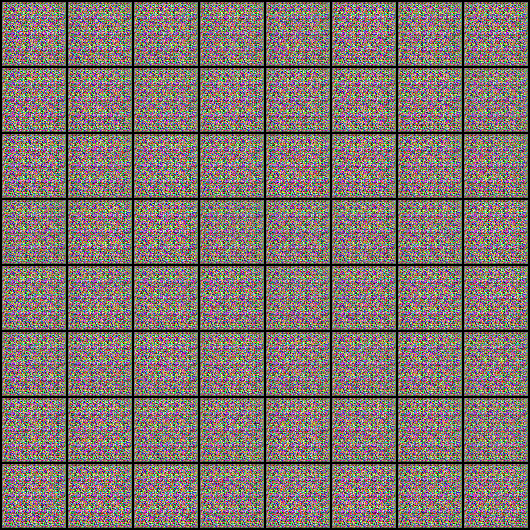

In [ ]:
Image('./generated/generated-images-0001.png')

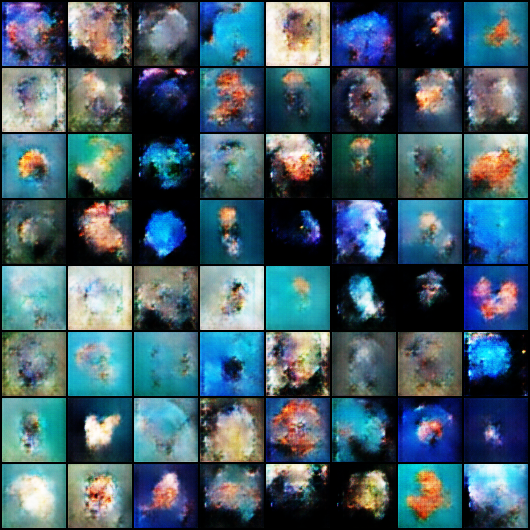

In [ ]:
Image('./generated/generated-images-0100.png')

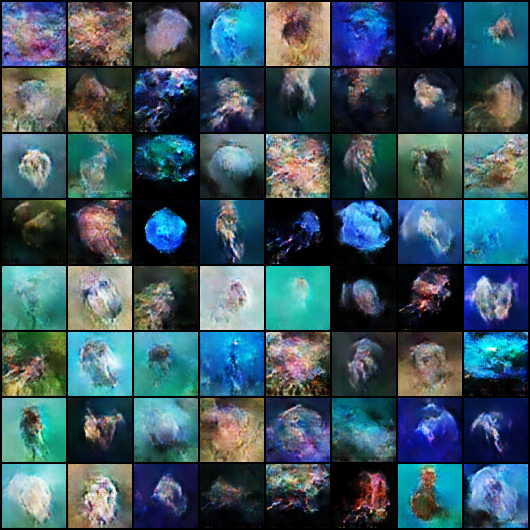

In [ ]:
Image('./generated/generated-images-0200.png')

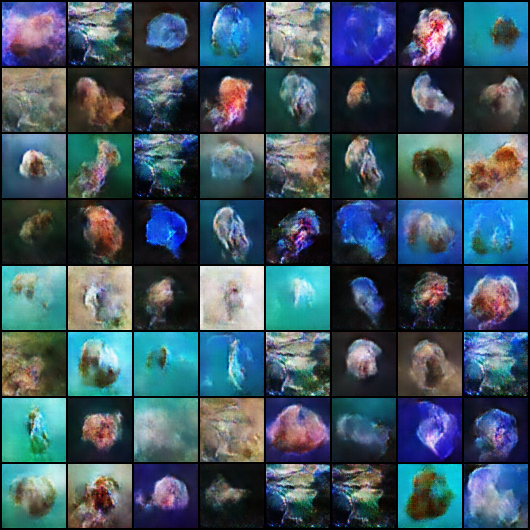

In [ ]:
Image('./generated/generated-images-0350.png')

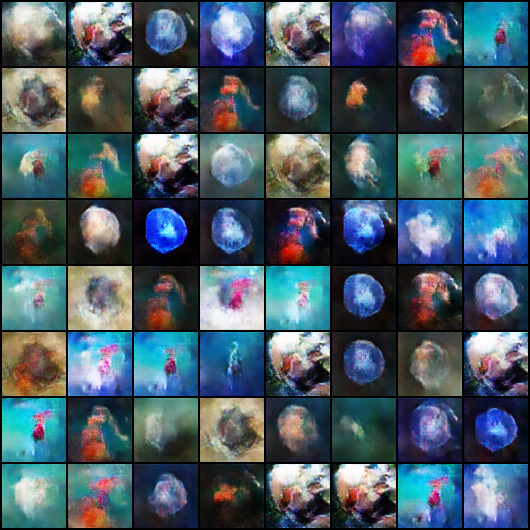

In [ ]:
Image('./generated/generated-images-0550.png')

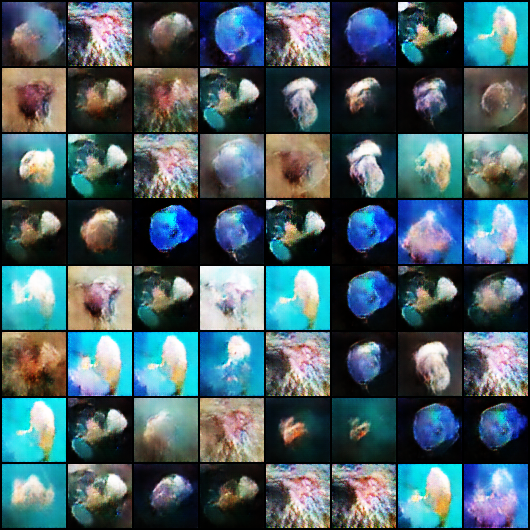

In [ ]:
Image('./generated/generated-images-0800.png')

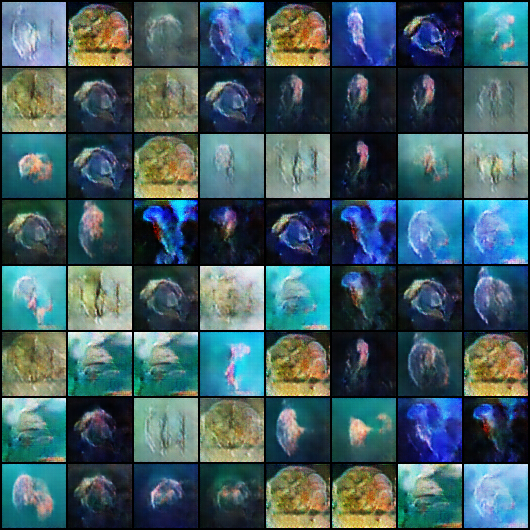

In [ ]:
Image('./generated/generated-images-0999.png')

We can visualize the training process by combining the sample images generated after each epoch into a video using OpenCV.

In [ ]:
import cv2
import os

vid_fname = 'gans_training.avi'

files = [os.path.join(sample_dir, f) for f in os.listdir(sample_dir) if 'generated' in f]
files.sort()

out = cv2.VideoWriter(vid_fname,cv2.VideoWriter_fourcc(*'MP4V'), 1, (530,530))
[out.write(cv2.imread(fname)) for fname in files]
out.release()

Here's what it looks like:

![]()


We can also visualize how the loss changes over time. Visualizing
losses is quite useful for debugging the training process. For GANs, we expect the generator's loss to reduce over time, without the discriminator's loss getting too high.



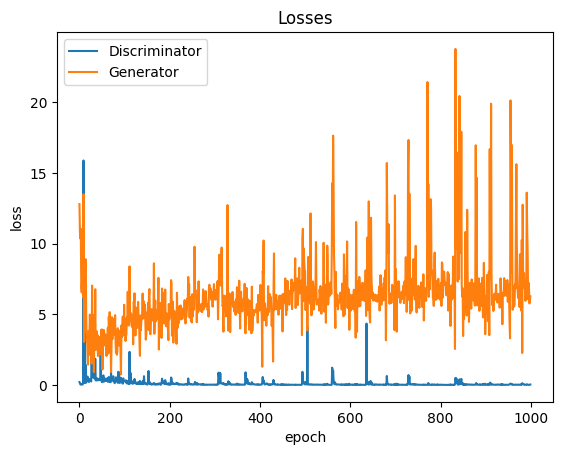

In [ ]:
losses_g, losses_d, real_scores, fake_scores = history
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

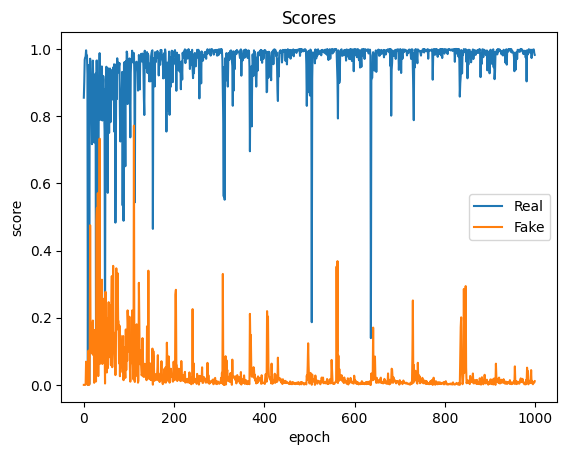

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');